In [1]:
import starry
import matplotlib.pyplot as plt
import numpy as np
import pymc3 as pm
import pymc3.math as pmm
import pymc3_ext as pmx
import exoplanet
from starry_process import StarryProcess, MCMCInterface
from starry_process.math import cho_factor, cho_solve
import starry_process 
import theano
theano.config.gcc__cxxflags += " -fexceptions"
theano.config.on_opt_error = "raise"
theano.tensor.opt.constant_folding
theano.graph.opt.EquilibriumOptimizer
import aesara_theano_fallback.tensor as tt
from theano.tensor.slinalg import cholesky
from corner import corner
import arviz as az
from matplotlib.colors import Normalize
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import os
from tqdm import tqdm
from theano.tensor.random.utils import RandomStream
import scipy.linalg as sl
import scipy.stats as ss
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import lightkurve as lk
import exoplanet as xo

starry.config.quiet = True
np.random.seed(1)

import warnings

# Ignore all warnings (not recommended, might hide other important warnings)
warnings.filterwarnings("ignore")

# Ignore specific warning by type
warnings.filterwarnings("ignore", message="Cannot construct a scalar test value from a test value with no size")

# Set logging level to ignore these warnings (recommended)
import logging
logger = logging.getLogger("theano.tensor.opt")
logger.setLevel(logging.ERROR)


WARNING (theano.link.c.cmodule): install mkl with `conda install mkl-service`: No module named 'mkl'
The version of PyMC you are using is very outdated.

Please upgrade to the latest version of PyMC https://www.pymc.io/projects/docs/en/stable/installation.html

Also notice that PyMC3 has been renamed to PyMC.
/Users/sabina/miniconda3/envs/starry-env/lib/python3.9/site-packages/lightkurve/config/__init__.py:119: UserWarning: The default Lightkurve cache directory, used by download(), etc., has been moved to /Users/sabina/.lightkurve/cache. Please move all the files in the legacy directory /Users/sabina/.lightkurve-cache to the new location and remove the legacy directory. Refer to https://docs.lightkurve.org/reference/config.html#default-cache-directory-migration for more information.
  warnings.warn(


In [2]:
%matplotlib inline

In [3]:
import sys
sys.path.insert(1, '/Users/sabina/Desktop/GitHub/starry-project/scripts')

from starry_starry_process import StarryStarryProcess

In [4]:
def gp_model(ts, fluxes, sigma_fluxes, params):
    # Helper function to instantiate parameters
    def parameter(name):
        param = params[name]
        if param.get("free", False):
            args = param.get("args", [])
            kwargs = param.get("kwargs", {})
            testval = param.get("testval", param["truth"])
            return param["dist"](name, *args, testval=testval, **kwargs)
            
        else:
            return param["truth"]
    
    starry.config.lazy = True
        
    with pm.Model() as model:

        prot = parameter('star.prot')

        porb = parameter('planet.porb')
        t0 = parameter('planet.t0')
        rp = parameter('planet.r')
        planet_inc = parameter('planet.inc')
        mp = parameter('planet.m')
        ecc = parameter('planet.ecc')
        Omega = parameter('planet.Omega')
        w = parameter('planet.w')

        map_model = starry.Map(ydeg=15, udeg=2)

        stellar_inc, stellar_obl = Stellar_Ori()
        # map_model.inc = parameter('star.inc')
        # map_model.obl = parameter('star.obl')
        map_model.inc = stellar_inc
        map_model.obl = stellar_obl
        
        map_model[1] = parameter('star.u1')
        map_model[2] = parameter('star.u2')
        
        pri_model = starry.Primary(map_model, 
            r=parameter('star.r'), 
            m=parameter('star.m'), 
            prot=prot)

        sec_model = starry.kepler.Secondary(starry.Map(0,0), 
            t0=t0, 
            r=rp, 
            m=mp, 
            porb=porb, 
            ecc=ecc, 
            Omega=Omega, 
            inc=planet_inc,
            w=w)
    
        sys_model = starry.System(pri_model, sec_model)

        sp_model = StarryProcess(
            a = parameter("gp.a"),
            b = parameter("gp.b"),
            c = parameter("gp.c"),
            r = parameter("gp.r"),
            n = parameter("gp.n"),
            ydeg = 15,
        )
        
        K00 = 0.
        K01 = 10.
        K10 = np.log(0.5)
        K11 = 10.
        alpha = tt.exp(K00 + (K10 - K00) * sp_model.a)
        beta = tt.exp(K10 + (K11 - K10) * sp_model.b) 

        pm.Deterministic('sp.mu', alpha / (alpha + beta) * 180 / np.pi)
        pm.Deterministic('sp.var', alpha * beta / (tt.square(alpha + beta) * (alpha + beta + 1)) * 180 / np.pi)

        for i in range(len(ts)):
            ssp_model = StarryStarryProcess(sys_model, sp_model)
            ssp_model.compute(ts[i], fluxes[i], sigma_fluxes[i])

            pm.Deterministic(f'flux_model_{i}', tt.dot(ssp_model.design_matrix, ssp_model.sample_ylm_conditional(ts[i], fluxes[i], sigma_fluxes[i])[0]))
            pm.Deterministic(f'max_map_{i}', ssp_model._a)
            
            pm.Potential(f'marginal_likelihood_{i}', ssp_model.marginal_likelihood(ts[i], fluxes[i], sigma_flux=sigma_fluxes[i]))


    return model

In [5]:
def bin_out_of_transit(t, flux, err, params, dt=0.06, binsize=30):
    """
    Bin the out of transit points to speed things up.
    
    """
    # Find in-transit and out-of-transit points
    idx = np.zeros(len(t), dtype=bool)
    ntransits = int(np.ceil(t[-1] / params["planet.porb"]["truth"]))
    for n in range(ntransits):
        t0 = params["planet.t0"]["truth"] + n * params["planet.porb"]["truth"]
        idx |= ((t > t0 - dt) & (t < t0 + dt))
    t_in = t[idx]
    f_in = flux[idx]
    t_out = t[~idx]
    f_out = flux[~idx]

    # Make the size of the out-of-transit array divisible by binsize
    # so we can bin by simple array reshaping
    trim = len(t_out) % binsize
    t_out = t_out[:-trim]
    f_out = f_out[:-trim]

    # We need to be careful not to bin *across* the transit, so
    # let's NaN-out points right _before_ each transit
    f_out[np.where(np.diff(t_out) > 0.1)] = np.nan

    # Bin the out-of-transit data
    t_out = t_out.reshape(-1, binsize).mean(axis=1)
    f_out = f_out.reshape(-1, binsize).mean(axis=1)

    # Remove any nans (the averages *across* transits)
    idx = np.isnan(f_out)
    t_out = t_out[~idx]
    f_out = f_out[~idx]

    # Error arrays
    e_in = err[0] * np.ones_like(t_in)
    e_out = (err[0] / np.sqrt(binsize)) * np.ones_like(t_out)

    # Sort and merge the arrays
    t_ = np.concatenate((t_in, t_out))
    f_ = np.concatenate((f_in, f_out))
    e_ = np.concatenate((e_in, e_out))
    idx = np.argsort(t_)
    t_ = t_[idx]
    flux_ = f_[idx]
    err_ = e_[idx]

    return t_, flux_, err_

## Get a light curve

<Axes: xlabel='Time - 2457000 [BTJD days]', ylabel='Flux'>

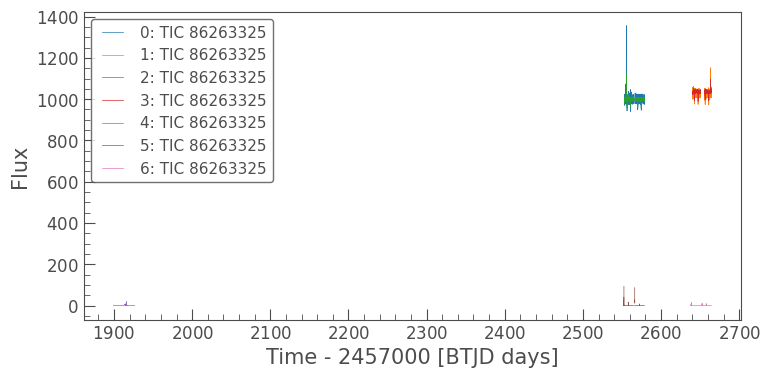

In [6]:
search_result = lk.search_lightcurve('TOI 3884')
lc_collection = search_result.download_all()
lc_collection.plot()

In [7]:
lc_collection

LightCurveCollection of 7 objects:
    0: <TessLightCurve LABEL="TIC 86263325" SECTOR=46 AUTHOR=SPOC FLUX_ORIGIN=pdcsap_flux>
    1: <TessLightCurve LABEL="TIC 86263325" SECTOR=49 AUTHOR=SPOC FLUX_ORIGIN=pdcsap_flux>
    2: <TessLightCurve LABEL="TIC 86263325" SECTOR=46 AUTHOR=SPOC FLUX_ORIGIN=pdcsap_flux>
    3: <TessLightCurve LABEL="TIC 86263325" SECTOR=49 AUTHOR=SPOC FLUX_ORIGIN=pdcsap_flux>
    4: <TessLightCurve LABEL="TIC 86263325" SECTOR=22 AUTHOR=QLP FLUX_ORIGIN=sap_flux>
    5: <TessLightCurve LABEL="TIC 86263325" SECTOR=46 AUTHOR=QLP FLUX_ORIGIN=sap_flux>
    6: <TessLightCurve LABEL="TIC 86263325" SECTOR=49 AUTHOR=QLP FLUX_ORIGIN=sap_flux>

In [8]:
lc_collection[0].time.value

array([2551.56457604, 2551.56596505, 2551.56735406, ..., 2578.69916336,
       2578.70055237, 2578.70194138])

In [9]:
lc_collection[1].time.value

array([2637.47827863, 2637.47966756, 2637.48105648, ..., 2664.31742913,
       2664.31881799, 2664.32020686])

In [10]:
lc_collection[2].time.value

array([2551.59235621, 2551.63402647, 2551.64097151, ..., 2578.68527324,
       2578.6922183 , 2578.69916336])

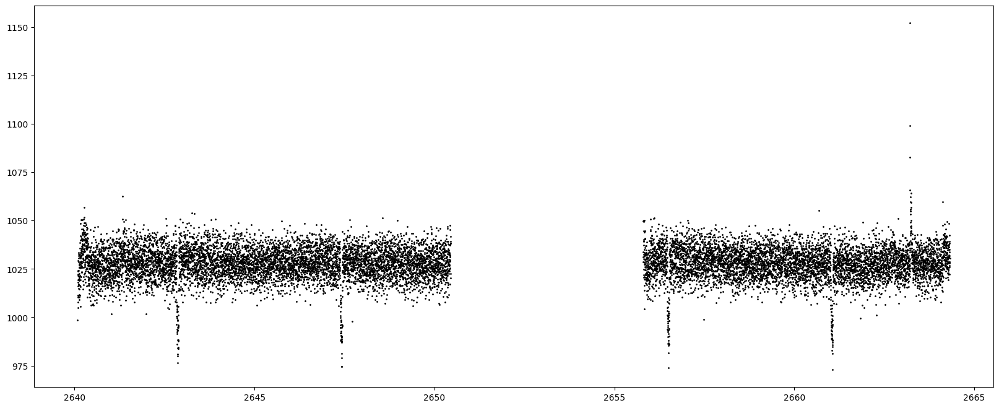

In [11]:
plt.figure(figsize=(20, 8))
plt.plot(lc_collection[1].time.value, lc_collection[1].flux, "k.", ms=2)
# plt.xlim(1335,1335.5)
plt.show()

In [12]:
lc1 = lc_collection[0].remove_nans()
lc1 = lc1[lc1.quality == 0]

lc4 = lc_collection[1].remove_nans()
lc4 = lc4[lc4.quality == 0]

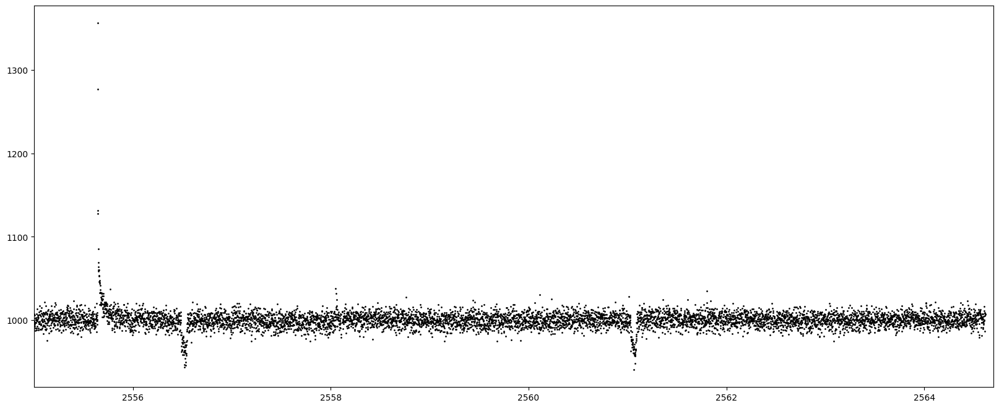

In [13]:
plt.figure(figsize=(20, 8))
plt.plot(lc1.time.value, lc1.flux, "k.", ms=2)
plt.xlim(2555,2564.7)
plt.show()

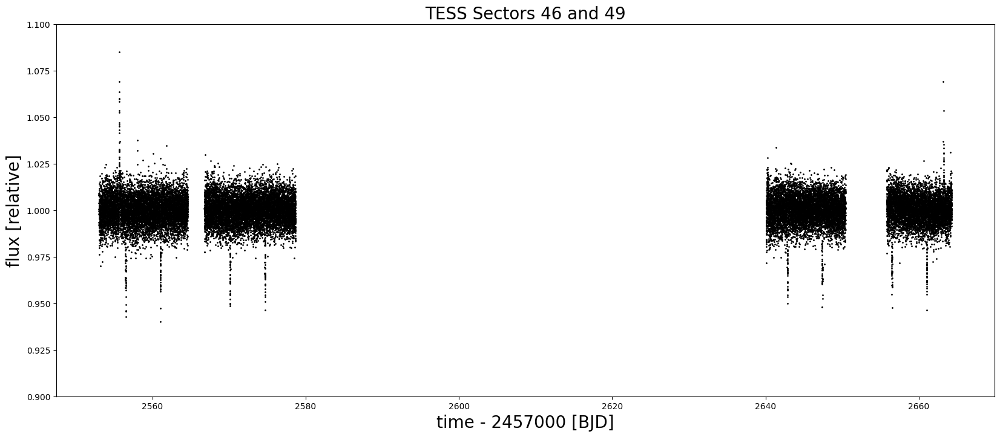

In [14]:
plt.figure(figsize=(20, 8))
plt.plot(lc1.time.value, lc1.flux / np.mean(lc1.flux), "k.", ms=2)
plt.ylim(0.9,1.1)
plt.ylabel("Relative Flux", fontsize=20)
plt.xlabel("Time - 2457000 [BJD]", fontsize=20)
# plt.legend(fontsize=16)
plt.plot(lc4.time.value, lc4.flux / np.mean(lc4.flux), "k.", ms=2)
plt.ylim(0.9,1.1)
plt.ylabel("flux [relative]", fontsize=20)
plt.xlabel("time - 2457000 [BJD]", fontsize=20)
# plt.legend(fontsize=16)
plt.title("TESS Sectors 46 and 49", fontsize=20)
# plt.show()
plt.savefig("/Users/sabina/Desktop/GitHub/polka-dotted-stars-hatp11/src/tex/figures/toi3884-lc.pdf", bbox_inches="tight", dpi=300)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


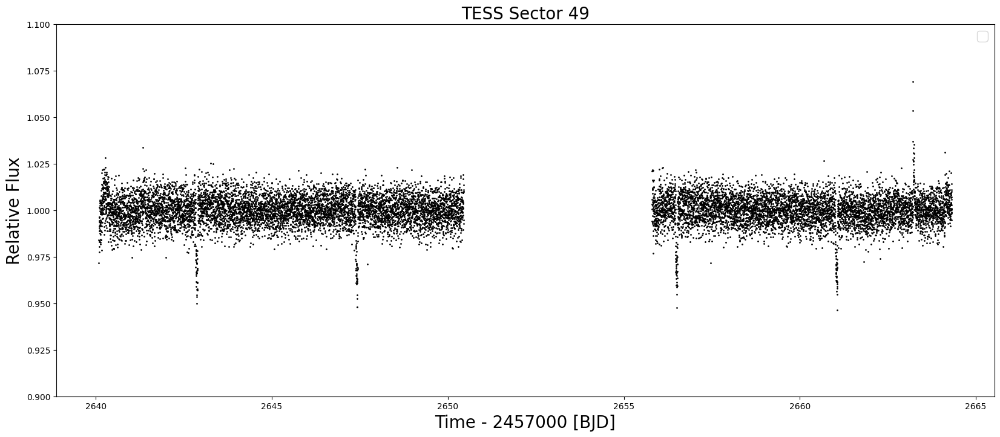

<Figure size 640x480 with 0 Axes>

In [15]:
plt.figure(figsize=(20, 8))
plt.plot(lc4.time.value, lc4.flux / np.mean(lc4.flux), "k.", ms=2)
plt.ylim(0.9,1.1)
plt.ylabel("Relative Flux", fontsize=20)
plt.xlabel("Time - 2457000 [BJD]", fontsize=20)
plt.legend(fontsize=16)
plt.title("TESS Sector 49", fontsize=20)
plt.show()
plt.savefig("/Users/sabina/Desktop/GitHub/polka-dotted-stars-hatp11/src/tex/figures/toi3884-sector49lc.pdf", bbox_inches="tight", dpi=300)

In [16]:
np.where(lc1.time.value > 2564.7)

(array([ 8336,  8337,  8338, ..., 16911, 16912, 16913]),)

In [17]:
chunk_times = []
chunk_fluxes = []
chunk_sigmas = []
chunk_times.append(lc1.time.value[:8336])
chunk_fluxes.append(np.ascontiguousarray(lc1.flux, dtype=np.float64)[:8336] / np.array(np.mean(lc1.flux)))
chunk_sigmas.append(np.ascontiguousarray(lc1.flux_err, dtype=np.float64)[:8336] / np.array(np.mean(lc1.flux)))

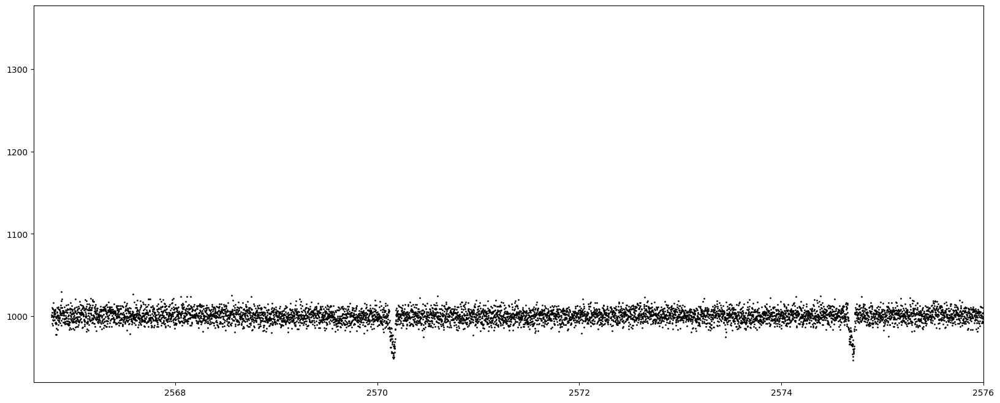

In [18]:
plt.figure(figsize=(20, 8))
plt.plot(lc1.time.value, lc1.flux, "k.", ms=2)
plt.xlim(2566.6,2576)
plt.show()

In [19]:
np.where(lc1.time.value>2566.6)

(array([ 8336,  8337,  8338, ..., 16911, 16912, 16913]),)

In [20]:
chunk_times.append(lc1.time.value[8336:])
chunk_fluxes.append(np.ascontiguousarray(lc1.flux, dtype=np.float64)[8336:] / np.array(np.mean(lc1.flux)))
chunk_sigmas.append(np.ascontiguousarray(lc1.flux_err, dtype=np.float64)[8336:] / np.array(np.mean(lc1.flux)))

In [21]:
total_t = np.concatenate((lc1.time.value, lc4.time.value))
total_flux = np.concatenate((np.ascontiguousarray(lc1.flux, dtype=np.float64)/ np.array(np.mean(lc1.flux)), np.ascontiguousarray(lc4.flux, dtype=np.float64)/ np.array(np.mean(lc4.flux))))
total_sigma = np.concatenate((np.ascontiguousarray(lc1.flux_err, dtype=np.float64)/ np.array(np.mean(lc1.flux)), np.ascontiguousarray(lc4.flux_err, dtype=np.float64)/ np.array(np.mean(lc4.flux))))

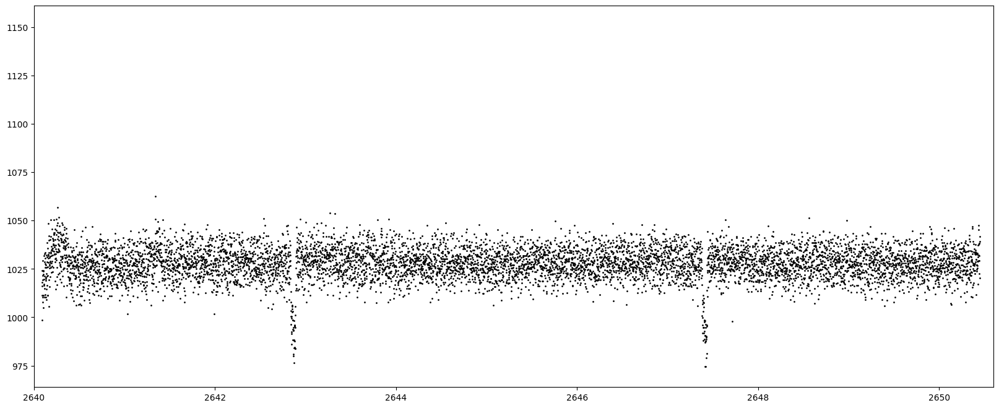

In [22]:
plt.figure(figsize=(20, 8))
plt.plot(lc_collection[1].time.value, lc_collection[1].flux, "k.", ms=2)
plt.xlim(2640,2650.6)
plt.show()

In [23]:
np.where(lc4.time.value>2650.6)

(array([ 7454,  7455,  7456, ..., 13578, 13579, 13580]),)

In [24]:
chunk_times.append(lc4.time.value[:7454])
chunk_fluxes.append(np.ascontiguousarray(lc4.flux, dtype=np.float64)[:7454] / np.array(np.mean(lc4.flux)))
chunk_sigmas.append(np.ascontiguousarray(lc4.flux_err, dtype=np.float64)[:7454] / np.array(np.mean(lc4.flux)))

chunk_times.append(lc4.time.value[7454:])
chunk_fluxes.append(np.ascontiguousarray(lc4.flux, dtype=np.float64)[7454:] / np.array(np.mean(lc4.flux)))
chunk_sigmas.append(np.ascontiguousarray(lc4.flux_err, dtype=np.float64)[7454:] / np.array(np.mean(lc4.flux)))

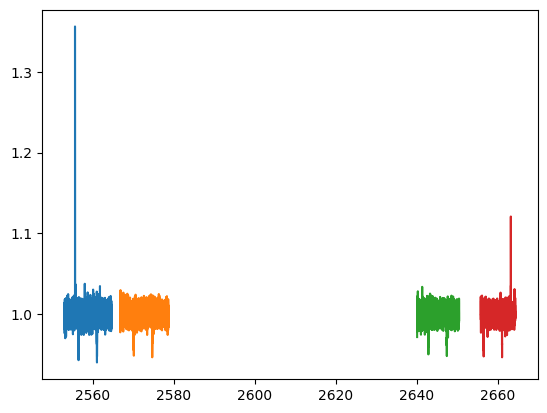

In [25]:
for i in range(len(chunk_times)):
    plt.plot(chunk_times[i], chunk_fluxes[i])

In [26]:
def remove_flares(t, flux, flux_err, window_size=100, sigma=1e-4):
    t_clean = []
    flux_clean = []
    flux_err_clean = []

    for i in range(len(t)):
        start = max(0, i - window_size // 2)
        end = min(len(t), i + window_size // 2)

        mean = np.mean(flux[start:end])
        std = np.std(flux[start:end])

        threshold = 1.025 #mean + sigma * std
        # print(threshold)

        if flux[i] < threshold:
            t_clean.append(t[i])
            flux_clean.append(flux[i])
            flux_err_clean.append(flux_err[i])

    t_clean = np.array(t_clean)
    flux_clean = np.array(flux_clean)
    flux_err_clean = np.array(flux_err_clean)

    return t_clean, flux_clean, flux_err_clean

t_clean, flux_clean, flux_err_clean = remove_flares(chunk_times[3], chunk_fluxes[3], chunk_sigmas[3])

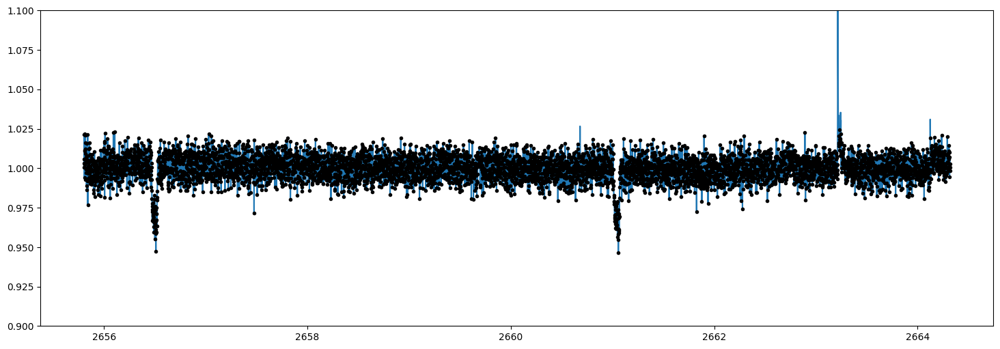

In [27]:
plt.figure(figsize=(18,6))
plt.plot(chunk_times[3], chunk_fluxes[3])
plt.plot(t_clean, flux_clean, 'k.')
# plt.xlim(2040,2042)
plt.ylim(0.9,1.1)
plt.show()

In [28]:
for i in range(len(chunk_times)):
    chunk_times[i], chunk_fluxes[i], chunk_sigmas[i] = remove_flares(chunk_times[i], chunk_fluxes[i], chunk_sigmas[i])

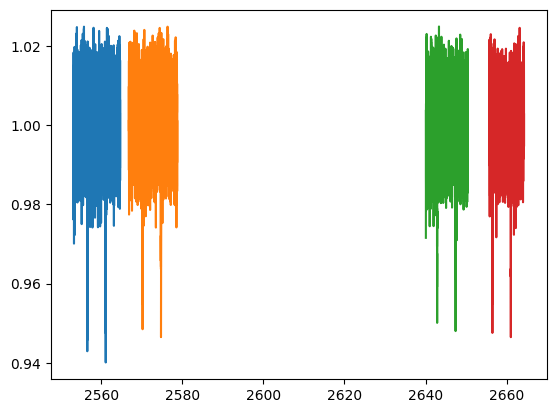

In [29]:
for i in range(len(chunk_times)):
    plt.plot(chunk_times[i], chunk_fluxes[i])

In [30]:
def Inclination(name, testval=30):
    """
    An isotropic distribution for inclination angles (in degrees).
    
    """
    def logp(x):
        return tt.log(np.pi / 180 * tt.sin(x * np.pi / 180))

    def random(*args, **kwargs):
        return tt.arccos(pm.Uniform.dist(0, 1).random(*args, **kwargs)) * 180 / np.pi

    return pm.DensityDist(
        name,
        logp,
        random=random,
        initval=testval,
    )

def Angle(*args, **kwargs):
    """
    A uniform distribution for angles in [-180, 180).
    
    """
    if kwargs.get("testval", None) is not None:
        kwargs["testval"] *= np.pi / 180
    return 180 / np.pi * pmx.Angle(*args, **kwargs)

def Planet_Inc(name, *args, **kwargs):
    bmax = params[name].get('bmax')
    b = pm.Uniform('b', -bmax, bmax)
    planet_inc = pm.Deterministic(name, 180.0/np.pi*np.arccos(b))
    
    return planet_inc

def Planet_w(name, *args, **kwargs):
    w_x = pm.Normal('w_x', mu=0, sigma=1, testval=1)
    w_y = pm.Normal('w_y', mu=0, sigma=1, testval=1)
    planet_w = pm.Deterministic(name, 180.0/np.pi*tt.arctan2(w_y, w_x))
    
    return planet_w

def xyz_transform(x_, y_, z_):
    x = x_
    y = (np.sqrt(2)/2) * (z_ + y_)
    z = (np.sqrt(2)/2) * (z_ - y_)

    return x, y, z

def xyz_transform_back(x, y, z):
    x_ = x
    y_ = (np.sqrt(2)/2) * (y - z)
    z_ = (np.sqrt(2)/2) * (y + z)

    return x_, y_, z_

def Stellar_Ori():
    stellar_ori_x_ = pm.Normal('stellar_ori_x_', mu=0, sigma=1, testval=1)
    stellar_ori_y_ = pm.Normal('stellar_ori_y_', mu=0, sigma=1, testval=1)
    stellar_ori_z_ = pm.HalfNormal('stellar_ori_z_', sigma=1, testval=1)

    stellar_ori_x, stellar_ori_y, stellar_ori_z = xyz_transform(stellar_ori_x_, stellar_ori_y_, stellar_ori_z_)

    stellar_obl = pm.Deterministic('star.obl', 180.0/np.pi*tt.arctan2(stellar_ori_y, stellar_ori_x))
    stellar_inc = pm.Deterministic('star.inc', 180.0/np.pi*tt.arccos(stellar_ori_z / tt.sqrt(tt.square(stellar_ori_x) + tt.square(stellar_ori_y) + tt.square(stellar_ori_z))))
    
    return stellar_inc, stellar_obl
    # if "inc" in name:
    #     return stellar_inc
    
    # elif "obl" in name:
    #     return stellar_obl

def Period(name, *args, **kwargs):
    Ttotal = t[-1] - t[0]
    frac_bounds = params[name].get('frac_bounds')

    if kwargs.get("testval", None) is not None:
        trueval = kwargs["testval"]

    def logp(trueval, frac_bounds):
        return pm.Uniform(name+'logp',tt.log(trueval) + np.log1p(-frac_bounds), tt.log(trueval) + np.log1p(frac_bounds))

    period = pm.Deterministic(name, tt.exp(logp(trueval, frac_bounds)))

    return period

def Logarithmic(name, *args, **kwargs):
    if kwargs.get("testval", None) is not None:
        trueval = kwargs["testval"]
    log_rp = pm.Uniform(name+'log', tt.log(trueval/2), tt.log(2*trueval))
    rp = pm.Deterministic(name, tt.exp(log_rp))

    return rp

# Shorthand for the usual Uniform distribution
Uniform = pm.Uniform

In [31]:
mSun = 1.989e33 # grams
mJ = 1.898e30 
rJ = 6.99e6 # cm
rSun = 69.634e6

mTOI3884 = 0.2813 * mSun
mTOI3884b = 0.0519 * mJ # grams
rTOI3884 = 0.3043 * rSun 
rTOI3884b = 0.535 * rJ # cm

In [32]:
mTOI3884 / mSun

0.2813

In [33]:
# True parameters & priors
params = {
    "planet.inc": {"truth": 85.85844557321126, "dist": Planet_Inc},
    "planet.ecc": {"truth": 0.48181713192128145, "dist": Uniform, "args": [0.0, 1.]},
    "planet.Omega": {"truth": 0.0, "dist": Angle},
    "planet.porb": {"truth": 4.544592163539594, "dist": Period},
    "planet.t0": {"truth": 2556.516, "dist": Uniform, "args": [2556, 2557]},
    "planet.r": {"truth": 0.1746426230950171, "dist": Logarithmic},
    "planet.m": {"truth":  mTOI3884b / mTOI3884, "dist": Uniform, "args": [4e-5, 4e-4]},
    "planet.w": {"truth": 190, "dist": Planet_w},

    "star.inc": {"truth": 115.45005374162783, "dist": Stellar_Ori},
    "star.m": {"truth": 1, "dist": Uniform, "args": [0.1, 0.3]},
    "star.u1": {"truth": 0.2886379996338223, "dist": Uniform, "args": [0.0, 0.5]},
    "star.u2": {"truth": 0.08500237661869868, "dist": Uniform, "args": [0.0, 0.2]},
    "star.prot": {"truth": 18, "dist": Period},
    "star.obl": {"truth": 62.31482288062067, "dist": Stellar_Ori},
    "star.r": {"truth": 1, "dist": Uniform, "args": [0.1, 0.4]},

    "gp.r": {"truth": 11.609196393800204, "dist": Uniform, "args": [10.0, 60.0]},
    "gp.c": {"truth": 0.4132101747490784, "dist": Uniform, "args": [0.1, 0.9]},
    "gp.n": {"truth": 3.3160051258826533, "dist": Uniform, "args": [0, 10]},
    "gp.a": {"truth": 0.023205943718544994, "dist": Uniform, "args": [0.0, 1.]},
    "gp.b": {"truth": 0.19272121091080988, "dist": Uniform, "args": [0.0, 1.]}
}

In [34]:
for i in range(len(chunk_times)):
    chunk_times[i], chunk_fluxes[i], chunk_sigmas[i] = bin_out_of_transit(chunk_times[i], chunk_fluxes[i], chunk_sigmas[i], params, dt=0.05, binsize=100)

In [35]:
t = np.concatenate(chunk_times)
flux_obs = np.concatenate(chunk_fluxes)
sigma_flux = np.concatenate(chunk_sigmas)

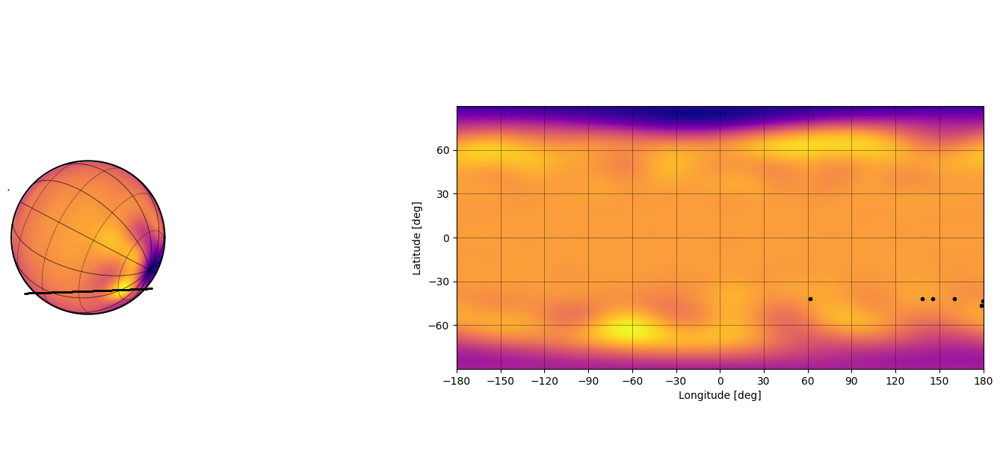

In [36]:
# Ttr_half = 0.1
# dt_in_transit = Ttr_half / 20.0
# dt_out_transit = params['star.prot']['truth'] / 20.0

# dt = 0.6
# idx = np.zeros(len(t_), dtype=bool)
# ntransits = int(np.ceil(t_[-1] / params["planet.porb"]["truth"]))
# for n in range(ntransits):
#     t0 = params["planet.t0"]["truth"] + n * params["planet.porb"]["truth"]
#     idx |= ((t_ > t0 - dt) & (t_ < t0 + dt))
# t_in = t_[idx]
# t_out = t_[~idx]
# flux_in = flux_[idx]
# flux_out = flux_[~idx]

# nt = len(t)

Ttotal = t[-1] - t[0]

# Setting the priors
# fraction bounds for period priors
prot_frac_bounds = min(params['star.prot']['truth']/Ttotal/100, 0.25)
porb_frac_bounds = min(params['planet.porb']['truth']/Ttotal/100, 0.25)

# Let's add this parameter to the parameter dictionary as a prior
params['star.prot']['frac_bounds'] = prot_frac_bounds
params['planet.porb']['frac_bounds'] = porb_frac_bounds

# semi-major axis
a = (params['star.m']['truth']*np.square(params['planet.porb']['truth']/365.25))**(1/3) * 215.03 # Solar radii
# impact parameter
bmax = params['star.r']['truth'] / a

# Let's add this parameter to the parameter dictionary as a prior
params['planet.inc']['bmax'] = bmax

# Plot the data

map = starry.Map(15, 2)
map.inc = params["star.inc"]["truth"]
map.obl = params["star.obl"]["truth"]
map[1] = params["star.u1"]["truth"]
map[2] = params["star.u2"]["truth"]
star = starry.Primary(map, r=params["star.r"]["truth"], m=params["star.m"]["truth"], prot=params["star.prot"]["truth"]) 
planet = starry.Secondary(
    starry.Map(0,0),
    inc=params["planet.inc"]["truth"],
    ecc=params["planet.ecc"]["truth"],
    Omega=params["planet.Omega"]["truth"],
    porb=params["planet.porb"]["truth"],
    t0=params["planet.t0"]["truth"],
    r=params["planet.r"]["truth"],
    m=params["planet.m"]["truth"],
    w=params["planet.w"]["truth"],
)

sys = starry.System(star, planet)
xo, yo, zo = sys.position(t)
xo = xo.eval()[1]
yo = yo.eval()[1]
zo = zo.eval()[1]
theta = (360 * t / params["star.prot"]["truth"]) % 360

# *** Draw 1 sample from the GP
sp = StarryProcess(
    a=params["gp.a"]["truth"],
    b=params["gp.b"]["truth"],
    r=params["gp.r"]["truth"],
    c=params["gp.c"]["truth"],
    n=params["gp.n"]["truth"],
)

y_true = sp.sample_ylm().eval().reshape(-1)
y_true[0] += 1

fig, ax = plt.subplots(1, 2, figsize=(20, 8))
idx = (zo > 0) | (xo ** 2 + yo ** 2 > 1)
ax[0].plot(xo[idx], yo[idx], "k.", ms=1);
ax[0].set_aspect(1)
ax[0].axis("off")
map[:, :] = y_true
map.show(ax=ax[0])
ax[0].set_ylim(-3, 3)
idx = (zo > 0) & (xo ** 2 + yo ** 2 < 1)
lat = 180 / np.pi * np.arcsin(yo[idx])
lon = 180 / np.pi * np.arcsin(xo[idx] / np.sqrt(1 - yo[idx] ** 2)) - theta[idx]
lon = (lon + 180) % 360 - 180
mask = np.append(np.array(lon[1:] > lon[:-1], dtype=float), 0)
mask[mask == 1] = np.nan
map.show(ax=ax[1], projection="rect")
ax[1].plot(lon, lat + mask, "k.");

In [277]:
planet.t0.eval()

array(2556.516)

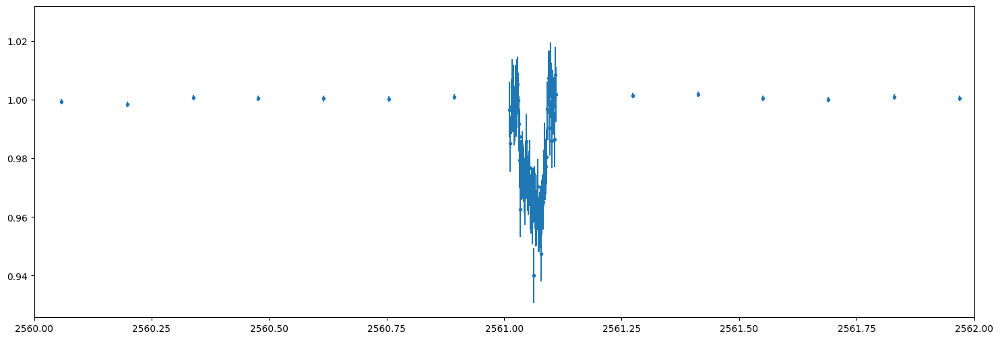

In [278]:
plt.figure(figsize=(18,6))
plt.errorbar(t, flux_obs, yerr=sigma_flux, fmt='.')
# plt.plot(t, ssp.design_matrix @ y_true)
plt.xlim(2560,2562)
plt.show()

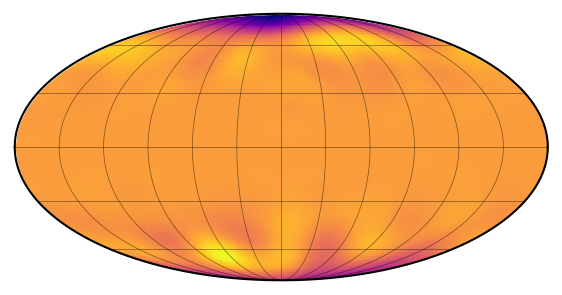

In [228]:
sp.visualize(y_true)

In [40]:
len(chunk_fluxes)

4

In [41]:
ssp = StarryStarryProcess(sys, sp)

# Inference

In [124]:
# Set some free params & get the model
p = dict(params)

p['planet.porb']['free'] = True
p['planet.t0']['free'] = True
p['planet.r']['free'] = True
p['planet.inc']['free'] = True
p['planet.ecc']['free'] = True
p['planet.w']['free'] = True

p['star.u1']['free'] = True
p['star.u2']['free'] = True

p['gp.c']['free'] = True
p['gp.a']['free'] = True
p['gp.b']['free'] = True
p['gp.r']['free'] = True
p['gp.n']['free'] = True

p['star.inc']['free'] = True
p['star.obl']['free'] = True
p['star.prot']['free'] = True

free = [x for x in p.keys() if p[x].get("free", False)]
model = gp_model([chunk_times[0]], [chunk_fluxes[0]], [chunk_sigmas[0]], p)

In [125]:
import warnings

# Ignore all warnings (not recommended, might hide other important warnings)
warnings.filterwarnings("ignore")

# Ignore specific warning by type
warnings.filterwarnings("ignore", message="Cannot construct a scalar test value from a test value with no size")

# Set logging level to ignore these warnings (recommended)
import logging
logger = logging.getLogger("theano.tensor.opt")
logger.setLevel(logging.ERROR)

In [126]:
with model:
    map_soln = pmx.optimize()
    for x in free:
        print(f"{x}: {map_soln[x]} {[params[x]['truth']]}")

optimizing logp for variables: [gp.n, gp.r, gp.c, gp.b, gp.a, star.u2, star.u1, stellar_ori_z_, stellar_ori_y_, stellar_ori_x_, w_y, w_x, planet.ecc, b, planet.rlog, planet.t0, planet.porblogp, star.protlogp]



planet.inc: 91.02940420792247 [85.85844557321126]
planet.ecc: 0.651596610166711 [0.48181713192128145]
planet.porb: 4.544541851276365 [4.544592163539594]
planet.t0: 2556.516300456995 [2556.516]
planet.r: 0.183061067018519 [0.1746426230950171]
planet.w: 93.94469070982146 [190]
star.inc: 79.19821225457461 [115.45005374162783]
star.u1: 0.2688509562120116 [0.2886379996338223]
star.u2: 0.08883839779731315 [0.08500237661869868]
star.prot: 17.99991668834528 [18]
star.obl: 89.37182272026095 [62.31482288062067]
gp.r: 12.343201719413495 [11.609196393800204]
gp.c: 0.2608776471335592 [0.4132101747490784]
gp.n: 3.7930063801199165 [3.3160051258826533]
gp.a: 0.5784241534289455 [0.023205943718544994]
gp.b: 0.46263077602959335 [0.19272121091080988]


message: Desired error not necessarily achieved due to precision loss.
logp: 746.366783745743 -> 858.1886414427593


(2556.0, 2558.0)

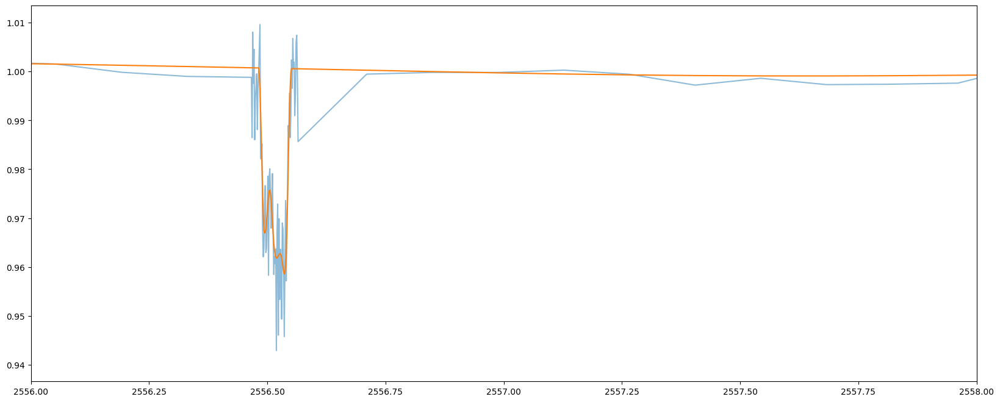

In [128]:
plt.figure(figsize=(20,8))
plt.plot(chunk_times[0], chunk_fluxes[0], '-', alpha=0.5)
plt.plot(chunk_times[0], map_soln['flux_model_0'], '-')
plt.xlim(2556,2558)

In [129]:
with model:
    trace = pmx.sample(
        tune=1000,
        draws=1000,
        start=map_soln,
        chains=1,
        cores=1,
        target_accept=0.9,
        return_inferencedata=False,
    )

The version of PyMC you are using is very outdated.

Please upgrade to the latest version of PyMC https://www.pymc.io/projects/docs/en/stable/installation.html

Also notice that PyMC3 has been renamed to PyMC.
Sequential sampling (1 chains in 1 job)
NUTS: [gp.n, gp.r, gp.c, gp.b, gp.a, star.u2, star.u1, stellar_ori_z_, stellar_ori_y_, stellar_ori_x_, w_y, w_x, planet.ecc, b, planet.rlog, planet.t0, planet.porblogp, star.protlogp]


Sampling 1 chain for 1_000 tune and 1_000 draw iterations (1_000 + 1_000 draws total) took 70746 seconds.
There were 14 divergences after tuning. Increase `target_accept` or reparameterize.
Only one chain was sampled, this makes it impossible to run some convergence checks


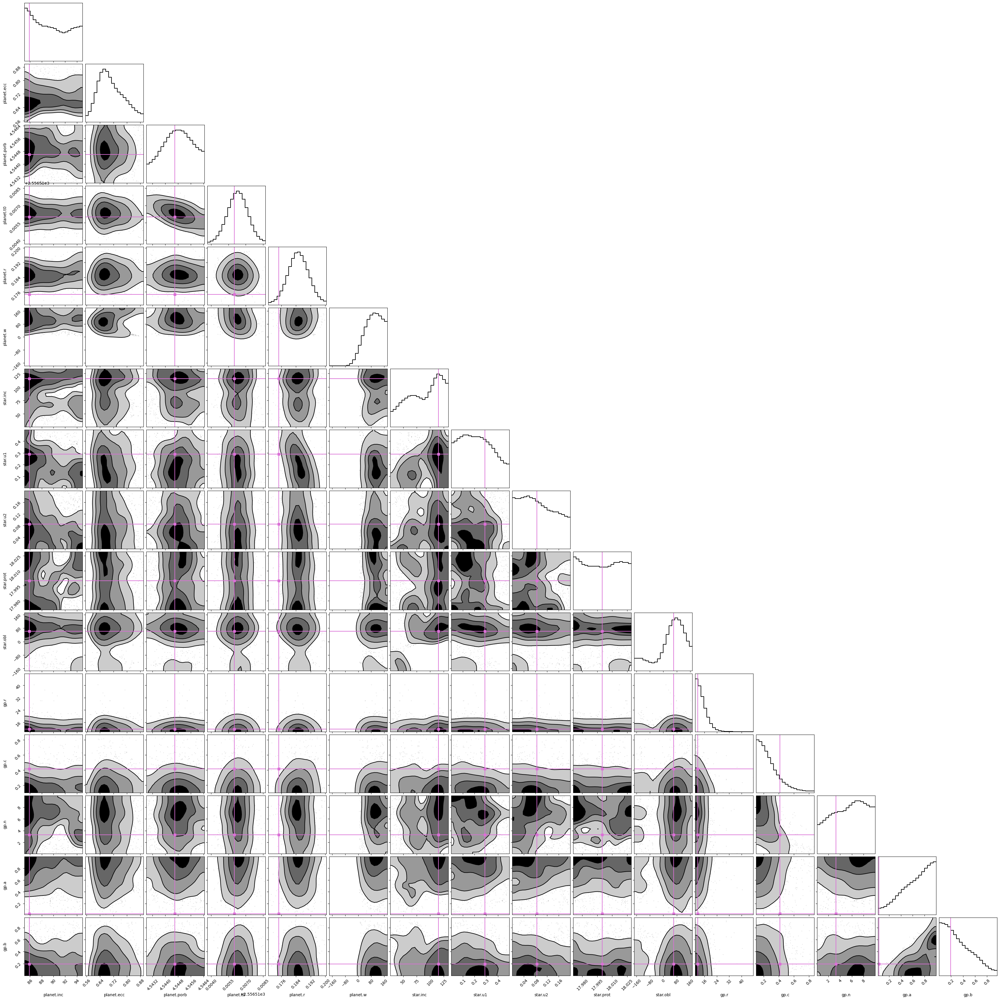

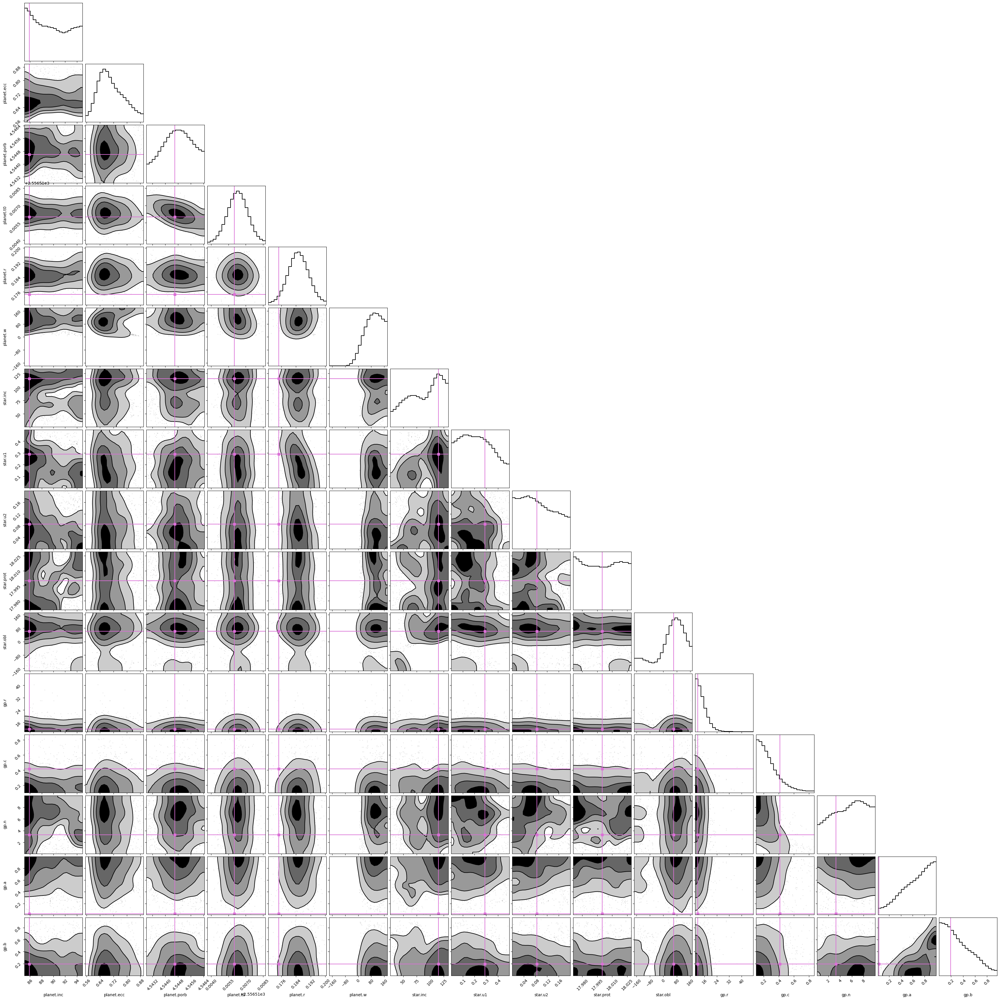

In [130]:
samples = pm.trace_to_dataframe(trace,varnames=free)
# samples = trace.posterior[free].to_dataframe()
corner(np.array(samples), labels=free,
        truths=[params[x]['truth'] for x in free], 
        color='k', 
        truth_color='orchid',
        plot_datapoints=True,
        plot_density=False,
        fill_contours=True,
        smooth=2.,
        smooth1d=2.,
        hist_kwargs=dict(alpha=1))

Got error No model on context stack. trying to find log_likelihood in translation.
Got error No model on context stack. trying to find log_likelihood in translation.


array([[<Axes: title={'center': 'planet.inc'}>,
        <Axes: title={'center': 'planet.inc'}>],
       [<Axes: title={'center': 'planet.ecc'}>,
        <Axes: title={'center': 'planet.ecc'}>],
       [<Axes: title={'center': 'planet.porb'}>,
        <Axes: title={'center': 'planet.porb'}>],
       [<Axes: title={'center': 'planet.t0'}>,
        <Axes: title={'center': 'planet.t0'}>],
       [<Axes: title={'center': 'planet.r'}>,
        <Axes: title={'center': 'planet.r'}>],
       [<Axes: title={'center': 'planet.w'}>,
        <Axes: title={'center': 'planet.w'}>],
       [<Axes: title={'center': 'star.inc'}>,
        <Axes: title={'center': 'star.inc'}>],
       [<Axes: title={'center': 'star.u1'}>,
        <Axes: title={'center': 'star.u1'}>],
       [<Axes: title={'center': 'star.u2'}>,
        <Axes: title={'center': 'star.u2'}>],
       [<Axes: title={'center': 'star.prot'}>,
        <Axes: title={'center': 'star.prot'}>],
       [<Axes: title={'center': 'star.obl'}>,
        <A

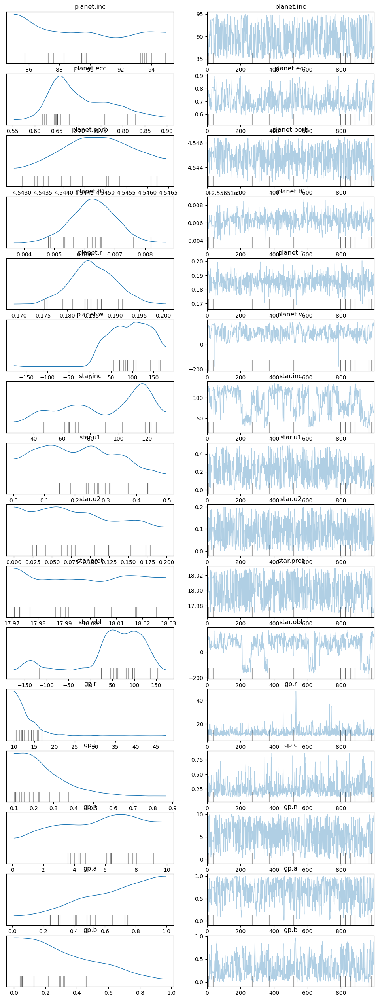

In [131]:
az.plot_trace(trace, var_names=free)

In [142]:
az.to_netcdf(trace,'SSP-TOI3884--s49s46-chunk1.nc')

Got error No model on context stack. trying to find log_likelihood in translation.


'SSP-TOI3884--s49s46-chunk1.nc'

In [143]:
samples_fromfile = az.from_netcdf('SSP-TOI3884--s49s46-chunk1.nc')

In [144]:
import random
chains = [trace[0]]

all_keys = set().union(*chains)
    
random_trace = {}
    
for key in all_keys:
    valid_chains = [chain for chain in chains if key in chain]
    
    if valid_chains:
        chosen_chain = random.choice(valid_chains)
        random_trace[key] = chosen_chain[key]

In [145]:
np.median(samples_fromfile.posterior['star.obl'].values)

63.48161263506817

In [136]:
random_trace

{'planet.porb': 4.545478745654371,
 'gp.b_interval__': 0.0026272378272106005,
 'gp.r': 14.84020487212266,
 'sp.var': 0.0028942477128254475,
 'star.prot': 17.99207153241442,
 'star.protlogp_interval__': -0.5559458762626784,
 'sp.mu': 0.3121448480025444,
 'planet.ecc_interval__': 0.9105108435043966,
 'planet.inc': 85.8947417358057,
 'flux_model_0': array([0.99821747, 0.9986751 , 0.99904776, 0.99933848, 0.99955959,
        0.99973055, 0.99987478, 1.00001612, 1.00017566, 1.0003693 ,
        1.00060621, 1.00088863, 1.00121262, 1.00155984, 1.00191417,
        1.00224904, 1.00253279, 1.00273829, 1.00284152, 1.00278913,
        1.00260182, 1.00229757, 1.00189922, 1.00144024, 1.00097169,
        1.00096691, 1.00096213, 1.00095735, 1.00095257, 1.00094779,
        1.00094302, 1.00093825, 1.00093348, 1.00092871, 1.00092395,
        1.00091919, 0.99982054, 0.99730329, 0.99376459, 0.98937089,
        0.98441021, 0.9792444 , 0.97427936, 0.96999825, 0.96730307,
        0.9665284 , 0.96656124, 0.967329

In [186]:
# Set some free params & get the model
p = dict(params)

p['planet.porb']['free'] = True
p['planet.t0']['free'] = True
p['planet.r']['free'] = True
p['planet.inc']['free'] = True
p['planet.ecc']['free'] = True
p['planet.w']['free'] = True

p['star.u1']['free'] = True
p['star.u2']['free'] = True

p['gp.c']['free'] = True
p['gp.a']['free'] = True
p['gp.b']['free'] = True
p['gp.r']['free'] = True
p['gp.n']['free'] = True

p['star.inc']['free'] = True
p['star.obl']['free'] = True
p['star.prot']['free'] = True

free = [x for x in p.keys() if p[x].get("free", False)]
model = gp_model(chunk_times[:2], chunk_fluxes[:2], chunk_sigmas[:2], p)

In [187]:
with model:
    trace = pmx.sample(
        tune=1000,
        draws=1000,
        start=random_trace,
        chains=1,
        cores=1,
        target_accept=0.9,
        return_inferencedata=False,
    )

The version of PyMC you are using is very outdated.

Please upgrade to the latest version of PyMC https://www.pymc.io/projects/docs/en/stable/installation.html

Also notice that PyMC3 has been renamed to PyMC.
Sequential sampling (1 chains in 1 job)
NUTS: [gp.n, gp.r, gp.c, gp.b, gp.a, star.u2, star.u1, stellar_ori_z_, stellar_ori_y_, stellar_ori_x_, w_y, w_x, planet.ecc, b, planet.rlog, planet.t0, planet.porblogp, star.protlogp]


Sampling 1 chain for 1_000 tune and 1_000 draw iterations (1_000 + 1_000 draws total) took 72324 seconds.
There were 38 divergences after tuning. Increase `target_accept` or reparameterize.
The acceptance probability does not match the target. It is 0.61751967553617, but should be close to 0.9. Try to increase the number of tuning steps.
Only one chain was sampled, this makes it impossible to run some convergence checks


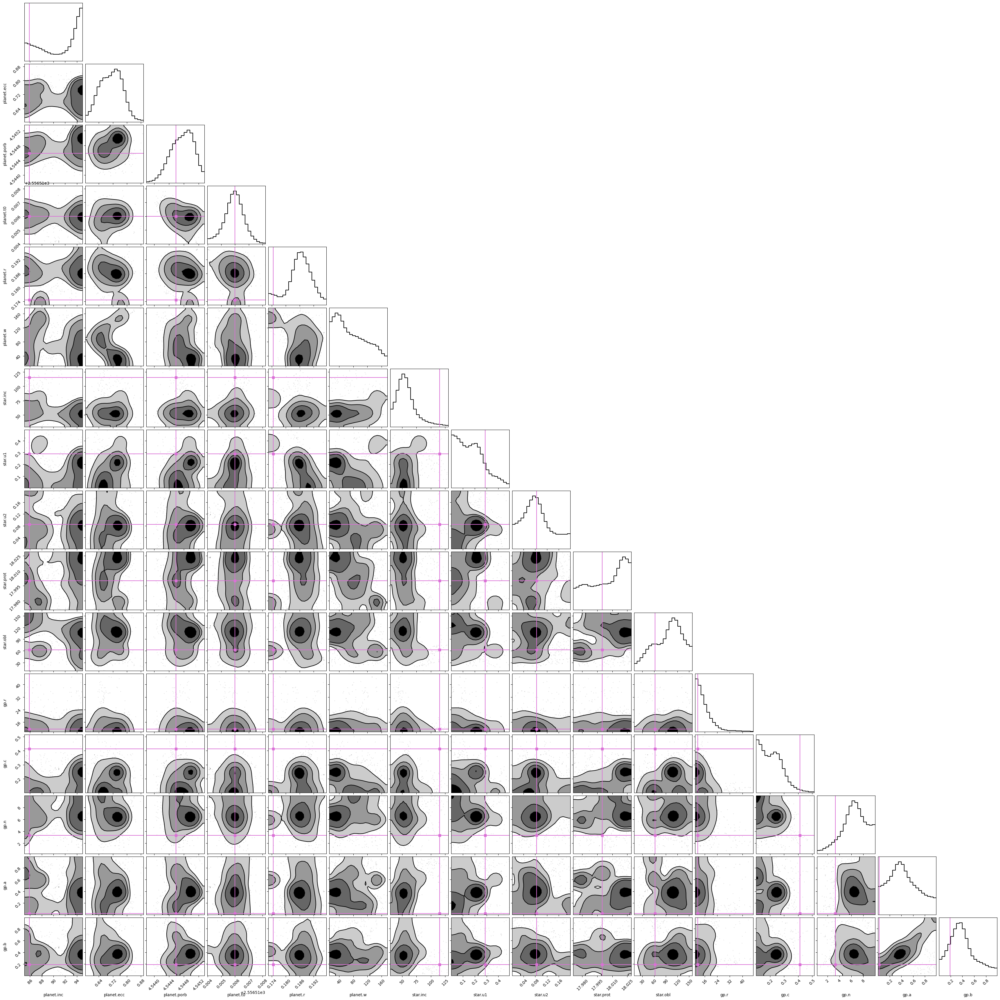

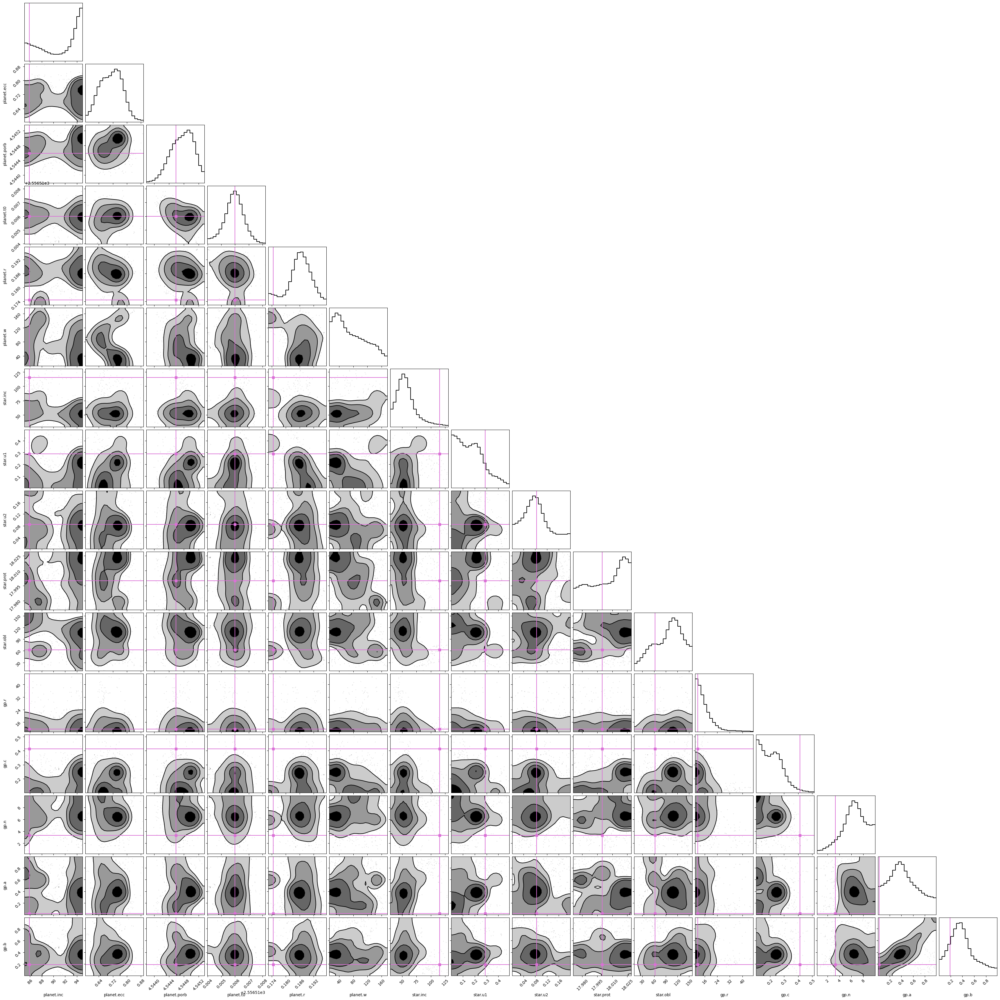

In [188]:
samples = pm.trace_to_dataframe(trace,varnames=free)
corner(np.array(samples), labels=free,
        truths=[params[x]['truth'] for x in free], 
        color='k', 
        truth_color='orchid',
        plot_datapoints=True,
        plot_density=False,
        fill_contours=True,
        smooth=2.,
        smooth1d=2.,
        hist_kwargs=dict(alpha=1))

Got error No model on context stack. trying to find log_likelihood in translation.
Got error No model on context stack. trying to find log_likelihood in translation.


array([[<Axes: title={'center': 'planet.inc'}>,
        <Axes: title={'center': 'planet.inc'}>],
       [<Axes: title={'center': 'planet.ecc'}>,
        <Axes: title={'center': 'planet.ecc'}>],
       [<Axes: title={'center': 'planet.porb'}>,
        <Axes: title={'center': 'planet.porb'}>],
       [<Axes: title={'center': 'planet.t0'}>,
        <Axes: title={'center': 'planet.t0'}>],
       [<Axes: title={'center': 'planet.r'}>,
        <Axes: title={'center': 'planet.r'}>],
       [<Axes: title={'center': 'planet.w'}>,
        <Axes: title={'center': 'planet.w'}>],
       [<Axes: title={'center': 'star.inc'}>,
        <Axes: title={'center': 'star.inc'}>],
       [<Axes: title={'center': 'star.u1'}>,
        <Axes: title={'center': 'star.u1'}>],
       [<Axes: title={'center': 'star.u2'}>,
        <Axes: title={'center': 'star.u2'}>],
       [<Axes: title={'center': 'star.prot'}>,
        <Axes: title={'center': 'star.prot'}>],
       [<Axes: title={'center': 'star.obl'}>,
        <A

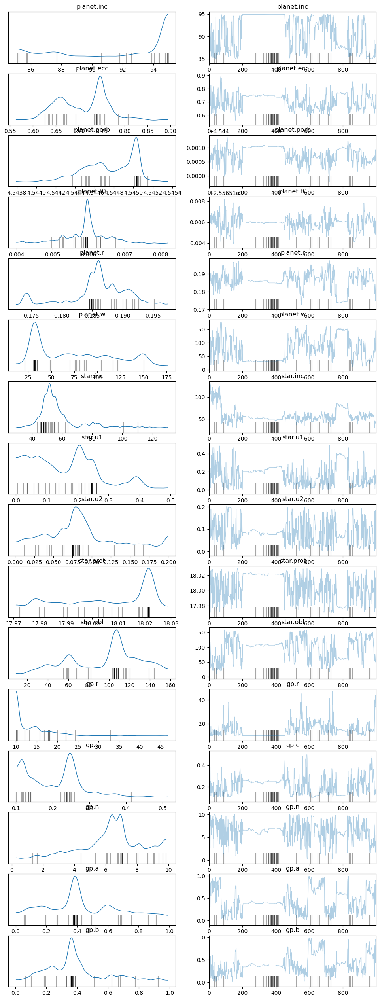

In [189]:
az.plot_trace(trace, var_names=free)

In [229]:
az.to_netcdf(trace,'SSP-TOI3884--s49s46-chunk2.nc')

Got error No model on context stack. trying to find log_likelihood in translation.


'SSP-TOI3884--s49s46-chunk2.nc'

In [230]:
chains = [trace[0]]

all_keys = set().union(*chains)
    
random_trace = {}
    
for key in all_keys:
    valid_chains = [chain for chain in chains if key in chain]
    
    if valid_chains:
        chosen_chain = random.choice(valid_chains)
        random_trace[key] = chosen_chain[key]

In [232]:
trace[0]

{'star.protlogp_interval__': 1.183856739250361,
 'planet.porblogp_interval__': 0.2631155691917341,
 'planet.t0_interval__': 0.06466624968800826,
 'planet.rlog_interval__': 0.03565380061299872,
 'b_interval__': 0.10243195514691056,
 'planet.ecc_interval__': 1.2099568870978632,
 'w_x': 0.6323396778743882,
 'w_y': 0.35438212450009504,
 'stellar_ori_x_': 0.7116484922999639,
 'stellar_ori_y_': 1.5695983745078848,
 'stellar_ori_z__log__': -0.5494361803409286,
 'star.u1_interval__': 1.3583271382973747,
 'star.u2_interval__': 2.715585762943491,
 'gp.a_interval__': 0.23170013614281681,
 'gp.b_interval__': -1.4040686059849539,
 'gp.c_interval__': -2.6851321393540344,
 'gp.r_interval__': -3.5647161067086617,
 'gp.n_interval__': 3.3940133585929364,
 'star.protlogp': 2.8912314901228293,
 'star.prot': 18.015481834242273,
 'planet.porblogp': 1.5139914304435131,
 'planet.porb': 4.544835032283903,
 'planet.t0': 2556.5161609311017,
 'planet.rlog': -1.7326581899646945,
 'planet.r': 0.17681378011929355,
 

In [231]:
random_trace

{'planet.porb': 4.544835032283903,
 'gp.b_interval__': -1.4040686059849539,
 'gp.r': 11.376294941667584,
 'sp.var': 1.2016332091327637,
 'star.prot': 18.015481834242273,
 'star.protlogp_interval__': 1.183856739250361,
 'sp.mu': 8.115061732939921,
 'flux_model_1': array([1.0001806 , 1.00033041, 1.0004726 , 1.00060826, 1.00073306,
        1.00083871, 1.00091373, 1.00094546, 1.00092557, 1.00085056,
        1.00072425, 1.00055789, 1.00036818, 1.00017442, 0.99999855,
        0.99985402, 0.99974945, 0.99968655, 0.99966106, 0.99966487,
        0.99968861, 0.99972383, 0.99976445, 0.99982463, 0.99982506,
        0.9998255 , 0.99982593, 0.99982636, 0.9998268 , 0.99982723,
        0.99982767, 0.9998281 , 0.99982854, 0.99982897, 0.99950215,
        0.99735451, 0.99398441, 0.98972563, 0.98486904, 0.97978381,
        0.97494729, 0.9710498 , 0.96951407, 0.96900686, 0.96891119,
        0.96899211, 0.96901246, 0.96880804, 0.96833483, 0.96765618,
        0.96688996, 0.96614871, 0.96549843, 0.96494684, 0

In [233]:
# Set some free params & get the model
p = dict(params)

p['planet.porb']['free'] = True
p['planet.t0']['free'] = True
p['planet.r']['free'] = True
p['planet.inc']['free'] = True
p['planet.ecc']['free'] = True
p['planet.w']['free'] = True

p['star.u1']['free'] = True
p['star.u2']['free'] = True

p['gp.c']['free'] = True
p['gp.a']['free'] = True
p['gp.b']['free'] = True
p['gp.r']['free'] = True
p['gp.n']['free'] = True

p['star.inc']['free'] = True
p['star.obl']['free'] = True
p['star.prot']['free'] = True

free = [x for x in p.keys() if p[x].get("free", False)]
model = gp_model(chunk_times[:3], chunk_fluxes[:3], chunk_sigmas[:3], p)

In [235]:
with model:
    trace = pmx.sample(
        tune=1000,
        draws=1000,
        start=random_trace,
        chains=4,
        cores=1,
        target_accept=0.9,
        return_inferencedata=False,
    )

The version of PyMC you are using is very outdated.

Please upgrade to the latest version of PyMC https://www.pymc.io/projects/docs/en/stable/installation.html

Also notice that PyMC3 has been renamed to PyMC.
Sequential sampling (4 chains in 1 job)
NUTS: [gp.n, gp.r, gp.c, gp.b, gp.a, star.u2, star.u1, stellar_ori_z_, stellar_ori_y_, stellar_ori_x_, w_y, w_x, planet.ecc, b, planet.rlog, planet.t0, planet.porblogp, star.protlogp]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 463635 seconds.
There were 32 divergences after tuning. Increase `target_accept` or reparameterize.
The acceptance probability does not match the target. It is 0.8389788742237002, but should be close to 0.9. Try to increase the number of tuning steps.
There were 72 divergences after tuning. Increase `target_accept` or reparameterize.
The acceptance probability does not match the target. It is 0.7957168747077707, but should be close to 0.9. Try to increase the number of tuning steps.
There were 107 divergences after tuning. Increase `target_accept` or reparameterize.
There were 121 divergences after tuning. Increase `target_accept` or reparameterize.
The rhat statistic is larger than 1.05 for some parameters. This indicates slight problems during sampling.
The estimated number of effective samples is smaller than 200 for some parameters.


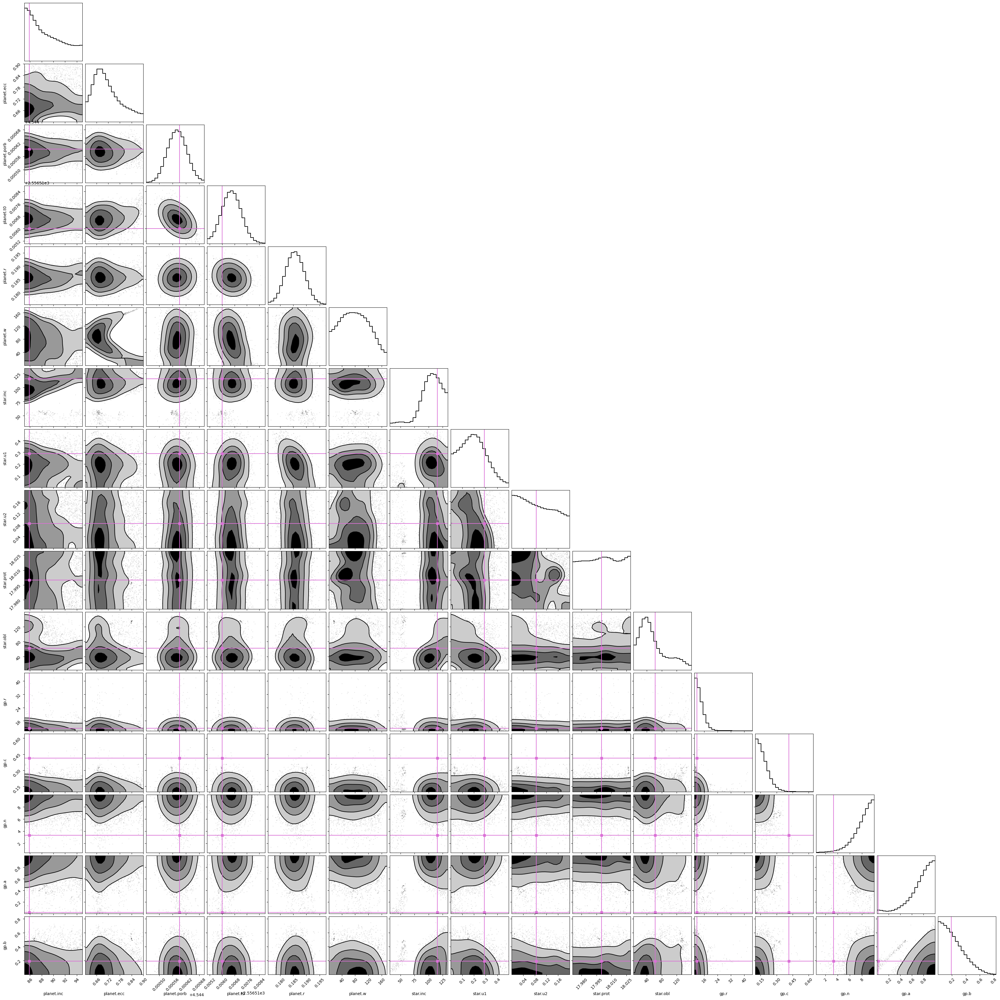

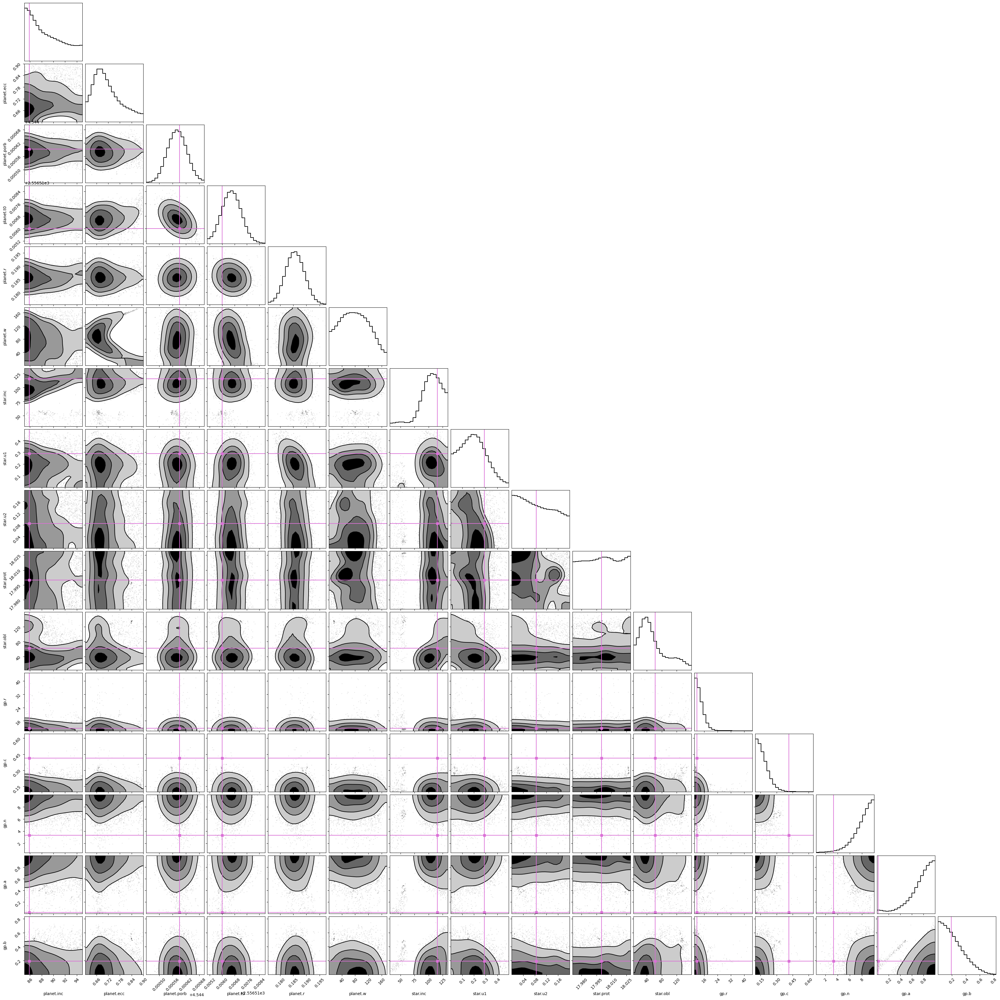

In [236]:
samples = pm.trace_to_dataframe(trace,varnames=free)
corner(np.array(samples), labels=free,
        truths=[params[x]['truth'] for x in free], 
        color='k', 
        truth_color='orchid',
        plot_datapoints=True,
        plot_density=False,
        fill_contours=True,
        smooth=2.,
        smooth1d=2.,
        hist_kwargs=dict(alpha=1))

Got error No model on context stack. trying to find log_likelihood in translation.
Got error No model on context stack. trying to find log_likelihood in translation.


array([[<Axes: title={'center': 'planet.inc'}>,
        <Axes: title={'center': 'planet.inc'}>],
       [<Axes: title={'center': 'planet.ecc'}>,
        <Axes: title={'center': 'planet.ecc'}>],
       [<Axes: title={'center': 'planet.porb'}>,
        <Axes: title={'center': 'planet.porb'}>],
       [<Axes: title={'center': 'planet.t0'}>,
        <Axes: title={'center': 'planet.t0'}>],
       [<Axes: title={'center': 'planet.r'}>,
        <Axes: title={'center': 'planet.r'}>],
       [<Axes: title={'center': 'planet.w'}>,
        <Axes: title={'center': 'planet.w'}>],
       [<Axes: title={'center': 'star.inc'}>,
        <Axes: title={'center': 'star.inc'}>],
       [<Axes: title={'center': 'star.u1'}>,
        <Axes: title={'center': 'star.u1'}>],
       [<Axes: title={'center': 'star.u2'}>,
        <Axes: title={'center': 'star.u2'}>],
       [<Axes: title={'center': 'star.prot'}>,
        <Axes: title={'center': 'star.prot'}>],
       [<Axes: title={'center': 'star.obl'}>,
        <A

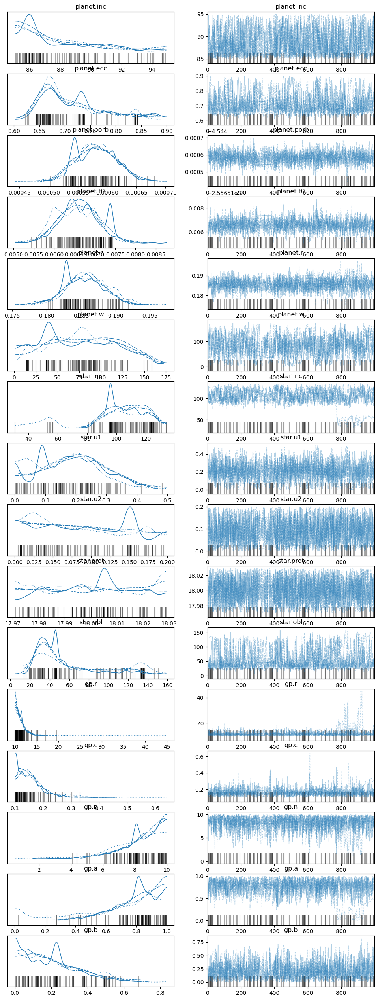

In [237]:
az.plot_trace(trace, var_names=free)

In [238]:
az.to_netcdf(trace,'SSP-TOI3884--s49s46-chunk3.nc')

Got error No model on context stack. trying to find log_likelihood in translation.


'SSP-TOI3884--s49s46-chunk3.nc'

In [239]:
chains = [trace[0], trace[1], trace[2], trace[3]]

all_keys = set().union(*chains)
    
random_trace = {}
    
for key in all_keys:
    valid_chains = [chain for chain in chains if key in chain]
    
    if valid_chains:
        chosen_chain = random.choice(valid_chains)
        random_trace[key] = chosen_chain[key]

In [240]:
random_trace

{'planet.porb': 4.54458675176461,
 'sp.var': 3.8725242830809226,
 'star.prot': 18.024301370011784,
 'flux_model_1': array([1.00091556, 1.00124942, 1.00153622, 1.00175942, 1.00190379,
        1.00196051, 1.00192777, 1.00181312, 1.0016299 , 1.00139558,
        1.00112948, 1.00085072, 1.00057607, 1.00031964, 1.00009693,
        0.9999151 , 0.99978075, 0.9996977 , 0.99966661, 0.9996844 ,
        0.99974369, 0.99983261, 0.99993526, 1.00006652, 1.00006728,
        1.00006805, 1.00006881, 1.00006957, 1.00007033, 1.00007108,
        1.00007183, 1.00007257, 1.00007332, 1.00007405, 1.00007479,
        0.9984241 , 0.99468366, 0.9897437 , 0.98409757, 0.9783045 ,
        0.97296765, 0.96874566, 0.96689047, 0.96778725, 0.96904868,
        0.970326  , 0.9712275 , 0.97150569, 0.97113863, 0.97029357,
        0.96922803, 0.96818645, 0.96732998, 0.96671183, 0.96629197,
        0.96597489, 0.96565274, 0.96524044, 0.96469557, 0.9640224 ,
        0.96326354, 0.96248464, 0.96175762, 0.96114634, 0.96069697,
 

In [279]:
# Set some free params & get the model
p = dict(params)

p['planet.porb']['free'] = True
p['planet.t0']['free'] = True
p['planet.r']['free'] = True
p['planet.inc']['free'] = True
p['planet.ecc']['free'] = True
p['planet.w']['free'] = True

p['star.u1']['free'] = True
p['star.u2']['free'] = True

p['gp.c']['free'] = True
p['gp.a']['free'] = True
p['gp.b']['free'] = True
p['gp.r']['free'] = True
p['gp.n']['free'] = True

p['star.inc']['free'] = True
p['star.obl']['free'] = True
p['star.prot']['free'] = True

free = [x for x in p.keys() if p[x].get("free", False)]
model = gp_model(chunk_times, chunk_fluxes, chunk_sigmas, p)

In [280]:
with model:
    trace = pmx.sample(
        tune=1000,
        draws=1000,
        start=random_trace,
        chains=4,
        cores=1,
        target_accept=0.9,
        return_inferencedata=False,
    )

The version of PyMC you are using is very outdated.

Please upgrade to the latest version of PyMC https://www.pymc.io/projects/docs/en/stable/installation.html

Also notice that PyMC3 has been renamed to PyMC.
Sequential sampling (4 chains in 1 job)
NUTS: [gp.n, gp.r, gp.c, gp.b, gp.a, star.u2, star.u1, stellar_ori_z_, stellar_ori_y_, stellar_ori_x_, w_y, w_x, planet.ecc, b, planet.rlog, planet.t0, planet.porblogp, star.protlogp]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 542114 seconds.
There were 14 divergences after tuning. Increase `target_accept` or reparameterize.
There were 39 divergences after tuning. Increase `target_accept` or reparameterize.
There were 49 divergences after tuning. Increase `target_accept` or reparameterize.
The acceptance probability does not match the target. It is 0.7722291236736987, but should be close to 0.9. Try to increase the number of tuning steps.
There were 68 divergences after tuning. Increase `target_accept` or reparameterize.
The rhat statistic is larger than 1.4 for some parameters. The sampler did not converge.
The estimated number of effective samples is smaller than 200 for some parameters.


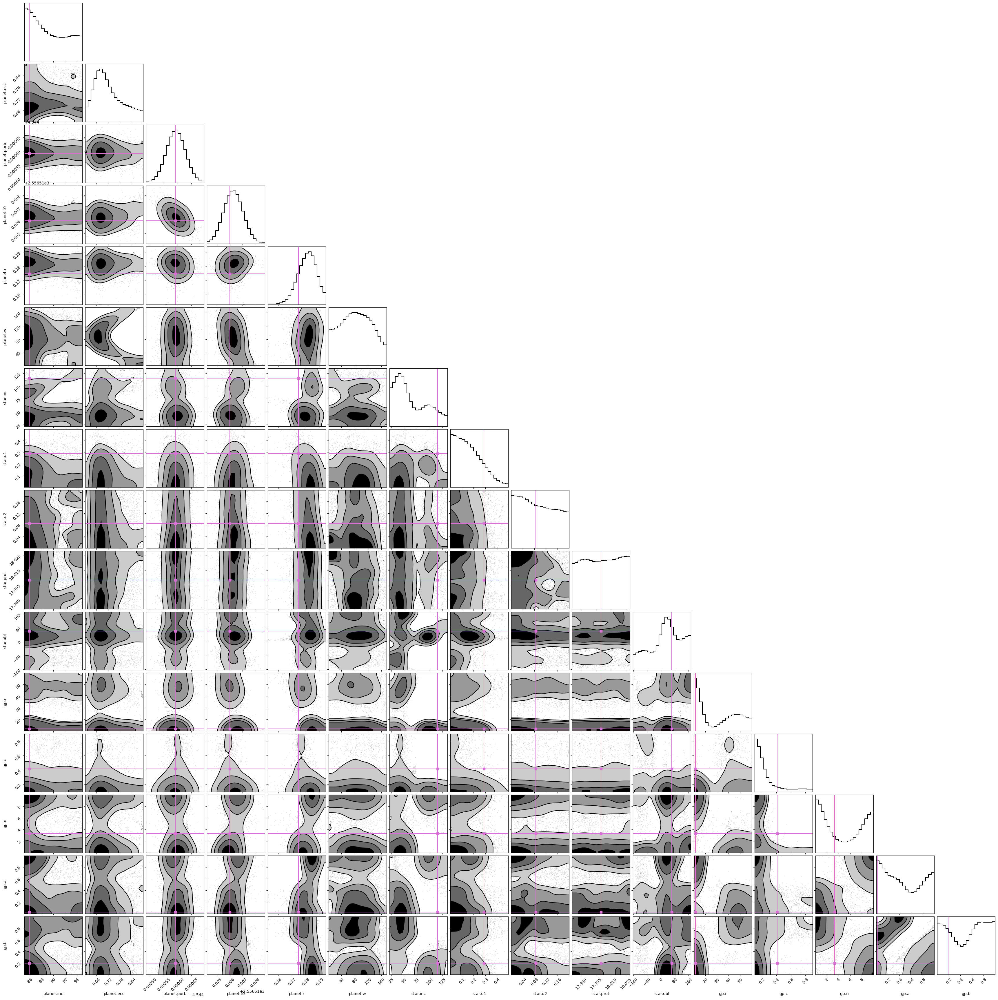

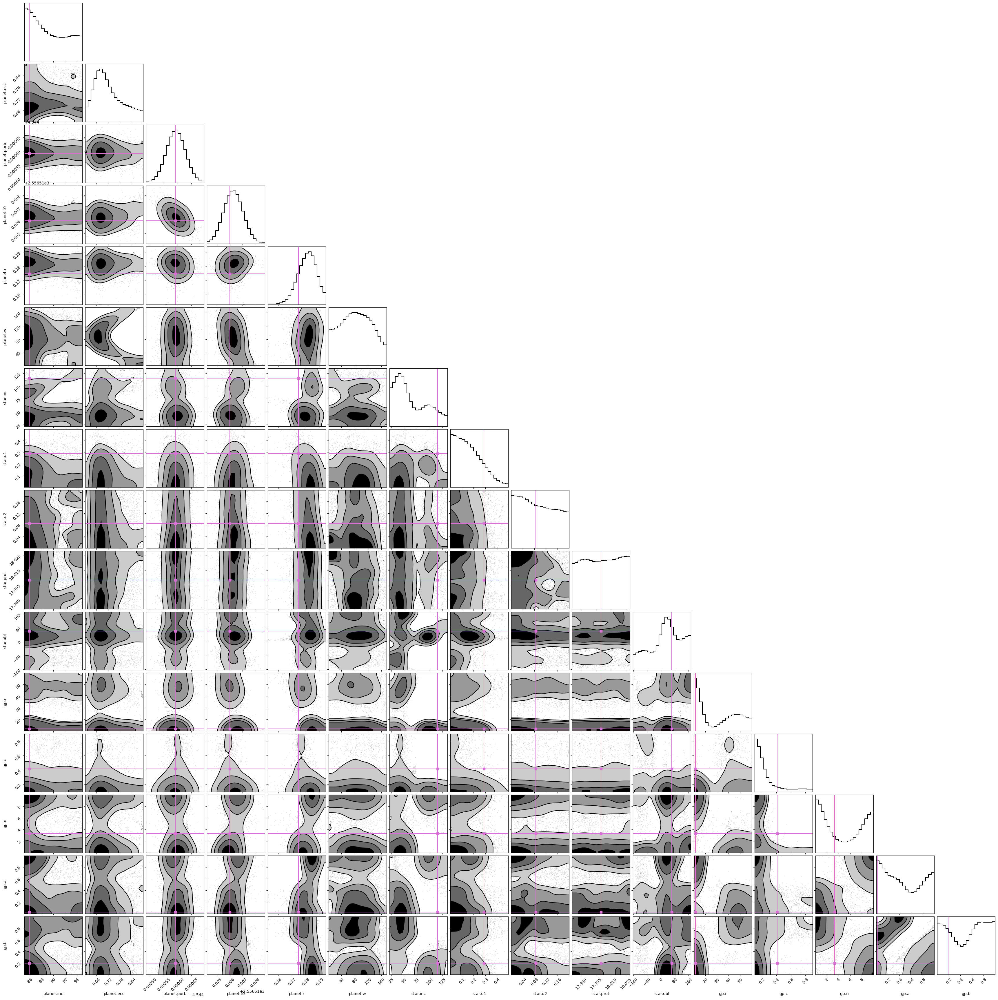

In [281]:
samples = pm.trace_to_dataframe(trace,varnames=free)
corner(np.array(samples), labels=free,
        truths=[params[x]['truth'] for x in free], 
        color='k', 
        truth_color='orchid',
        plot_datapoints=True,
        plot_density=False,
        fill_contours=True,
        smooth=2.,
        smooth1d=2.,
        hist_kwargs=dict(alpha=1))

Got error No model on context stack. trying to find log_likelihood in translation.


Got error No model on context stack. trying to find log_likelihood in translation.


array([[<Axes: title={'center': 'planet.inc'}>,
        <Axes: title={'center': 'planet.inc'}>],
       [<Axes: title={'center': 'planet.ecc'}>,
        <Axes: title={'center': 'planet.ecc'}>],
       [<Axes: title={'center': 'planet.porb'}>,
        <Axes: title={'center': 'planet.porb'}>],
       [<Axes: title={'center': 'planet.t0'}>,
        <Axes: title={'center': 'planet.t0'}>],
       [<Axes: title={'center': 'planet.r'}>,
        <Axes: title={'center': 'planet.r'}>],
       [<Axes: title={'center': 'planet.w'}>,
        <Axes: title={'center': 'planet.w'}>],
       [<Axes: title={'center': 'star.inc'}>,
        <Axes: title={'center': 'star.inc'}>],
       [<Axes: title={'center': 'star.u1'}>,
        <Axes: title={'center': 'star.u1'}>],
       [<Axes: title={'center': 'star.u2'}>,
        <Axes: title={'center': 'star.u2'}>],
       [<Axes: title={'center': 'star.prot'}>,
        <Axes: title={'center': 'star.prot'}>],
       [<Axes: title={'center': 'star.obl'}>,
        <A

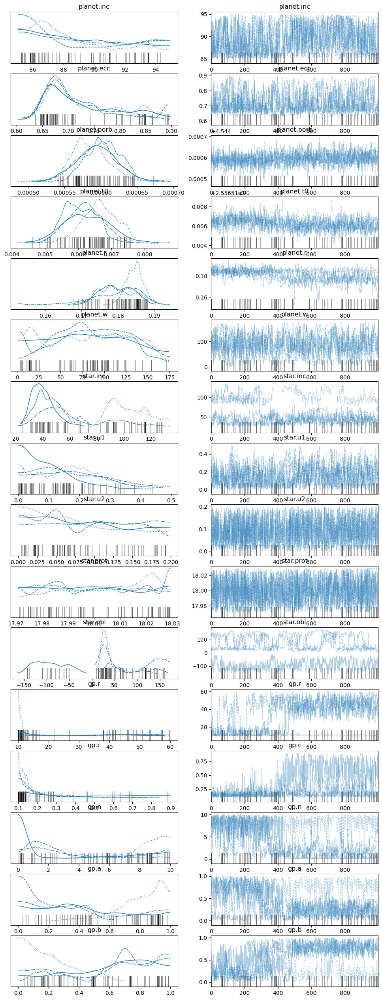

In [282]:
az.plot_trace(trace, var_names=free)

In [283]:
az.to_netcdf(trace,'SSP-TOI3884-all-s49s46.nc')

Got error No model on context stack. trying to find log_likelihood in translation.


'SSP-TOI3884-all-s49s46.nc'

In [37]:
# Set some free params & get the model
p = dict(params)

p['planet.porb']['free'] = True
p['planet.t0']['free'] = True
p['planet.r']['free'] = True
p['planet.inc']['free'] = True
p['planet.ecc']['free'] = True
p['planet.w']['free'] = True

p['star.u1']['free'] = True
p['star.u2']['free'] = True

p['gp.c']['free'] = True
p['gp.a']['free'] = True
p['gp.b']['free'] = True
p['gp.r']['free'] = True
p['gp.n']['free'] = True

p['star.inc']['free'] = True
p['star.obl']['free'] = True
p['star.prot']['free'] = True

free = [x for x in p.keys() if p[x].get("free", False)]
model = gp_model(chunk_times, chunk_fluxes, chunk_sigmas, p)

In [38]:
samples_fromfile = az.from_netcdf('SSP-TOI3884-all-s49s46.nc')

In [107]:
traces_dict0 = {var: samples_fromfile.posterior[var].values[0].mean(axis=0) for var in samples_fromfile.posterior.data_vars}
traces_dict1 = {var: samples_fromfile.posterior[var].values[1].mean(axis=0) for var in samples_fromfile.posterior.data_vars}
traces_dict2 = {var: samples_fromfile.posterior[var].values[2].mean(axis=0) for var in samples_fromfile.posterior.data_vars}
traces_dict3 = {var: samples_fromfile.posterior[var].values[3].mean(axis=0) for var in samples_fromfile.posterior.data_vars}

In [108]:
start_positions = {'0': traces_dict0,
                   '1': traces_dict1,
                   '2': traces_dict2,
                   '3': traces_dict3}

start_positions['0']['star.inc'] = 40.
start_positions['1']['star.inc'] = 40.

start_positions['2']['star.inc'] = 100.
start_positions['3']['star.inc'] = 100.

In [109]:
init = [start_positions['0'], start_positions['1'], start_positions['2'], start_positions['3']]

In [111]:
init[0]['star.inc']

40.0

In [112]:
with model:
    trace = pmx.sample(
        tune=1000,
        draws=1000,
        start=init,
        chains=4,
        cores=1,
        target_accept=0.9,
        return_inferencedata=False,
    )

The version of PyMC you are using is very outdated.

Please upgrade to the latest version of PyMC https://www.pymc.io/projects/docs/en/stable/installation.html

Also notice that PyMC3 has been renamed to PyMC.
Sequential sampling (4 chains in 1 job)
NUTS: [gp.n, gp.r, gp.c, gp.b, gp.a, star.u2, star.u1, stellar_ori_z_, stellar_ori_y_, stellar_ori_x_, w_y, w_x, planet.ecc, b, planet.rlog, planet.t0, planet.porblogp, star.protlogp]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 622202 seconds.
There were 51 divergences after tuning. Increase `target_accept` or reparameterize.
The acceptance probability does not match the target. It is 0.8226600775664622, but should be close to 0.9. Try to increase the number of tuning steps.
There were 68 divergences after tuning. Increase `target_accept` or reparameterize.
There were 79 divergences after tuning. Increase `target_accept` or reparameterize.
The acceptance probability does not match the target. It is 0.7404386590000288, but should be close to 0.9. Try to increase the number of tuning steps.
There were 96 divergences after tuning. Increase `target_accept` or reparameterize.
The rhat statistic is larger than 1.4 for some parameters. The sampler did not converge.
The estimated number of effective samples is smaller than 200 for some parameters.


In [117]:
az.to_netcdf(trace, 'SSP-TOI3884-all-s49s46.nc')

Got error No model on context stack. trying to find log_likelihood in translation.


'SSP-TOI3884-all-s49s46.nc'

In [118]:
samples_fromfile = az.from_netcdf('SSP-TOI3884-all-s49s46.nc')

In [119]:
samples_fromfile.sample_stats.lp.mean(dim="draw")

<xarray.DataArray 'lp' (chain: 4)>
array([3396.47119394, 3400.96097208, 3405.38309199, 3400.88672854])
Coordinates:
  * chain    (chain) int64 0 1 2 3

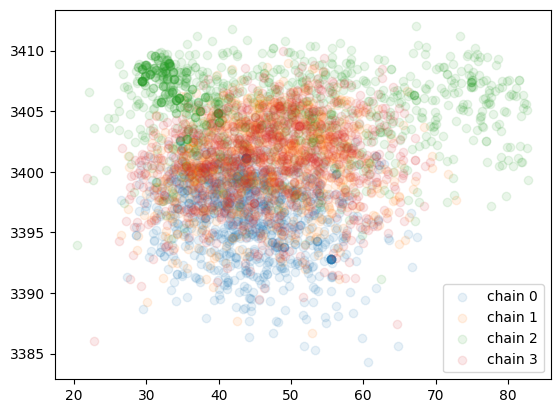

In [120]:
for c in samples_fromfile.posterior.chain:
    plt.scatter(samples_fromfile.posterior["star.inc"].sel(chain=c).values.flatten(), samples_fromfile.sample_stats.lp.sel(chain=c).values.flatten(), label="chain {}".format(int(c)), alpha=0.1)
plt.legend()

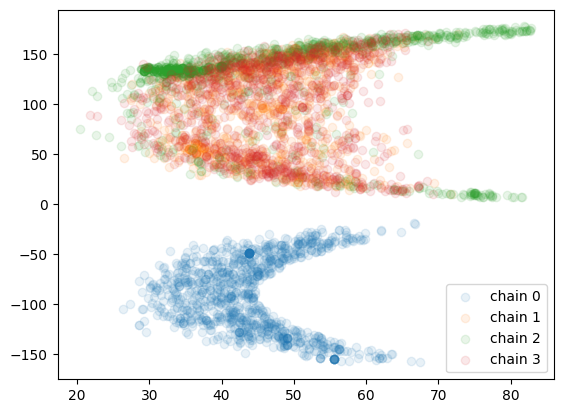

In [121]:
for c in samples_fromfile.posterior.chain:
    plt.scatter(samples_fromfile.posterior["star.inc"].sel(chain=c).values.flatten(), samples_fromfile.posterior["star.obl"].sel(chain=c).values.flatten(), label="chain {}".format(int(c)), alpha=0.1)
plt.legend()

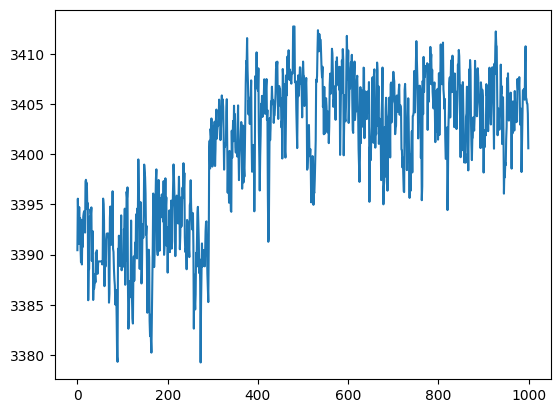

In [351]:
plt.plot(samples_fromfile.sample_stats.lp.sel(chain=3))

In [122]:
flux_from_posterior = np.concatenate((np.mean(samples_fromfile.posterior['flux_model_0'][0].values, axis=0), 
                                      np.mean(samples_fromfile.posterior['flux_model_1'][0].values, axis=0),
                                      np.mean(samples_fromfile.posterior['flux_model_2'][0].values, axis=0),
                                      np.mean(samples_fromfile.posterior['flux_model_3'][0].values, axis=0)))

In [123]:
t = np.concatenate(chunk_times)

(0.9, 1.1)

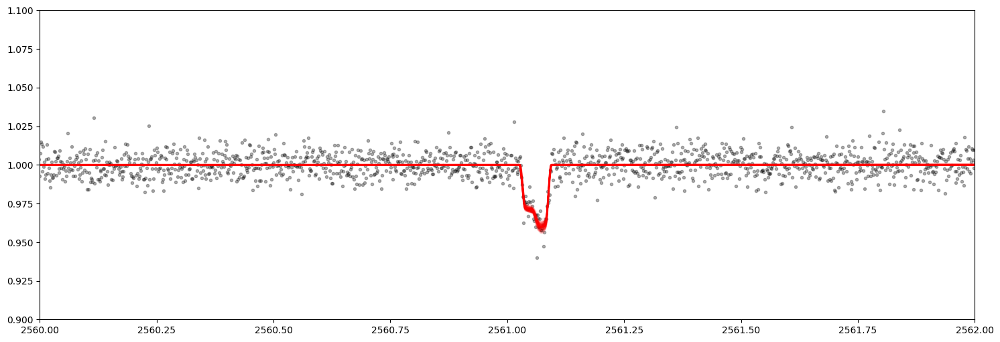

In [124]:
plt.figure(figsize=(18,6))
plt.plot(total_t, total_flux, '.', alpha=0.3, color='black')
plt.plot(t, flux_from_posterior, '-', color='red')
for _ in range(100):
    num = np.random.randint(500)
    plt.plot(t, np.concatenate((samples_fromfile.posterior['flux_model_0'][0].values[num, ...],
                                samples_fromfile.posterior['flux_model_1'][0].values[num, ...],
                                samples_fromfile.posterior['flux_model_2'][0].values[num, ...],
                                samples_fromfile.posterior['flux_model_3'][0].values[num, ...])), color='red', alpha=0.1)
# plt.xlim(2660, 2662)
plt.xlim(2560, 2562)
plt.ylim(0.9,1.1)

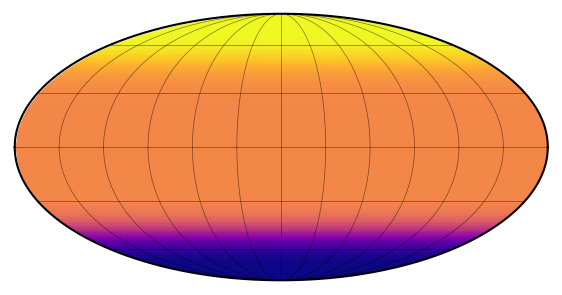

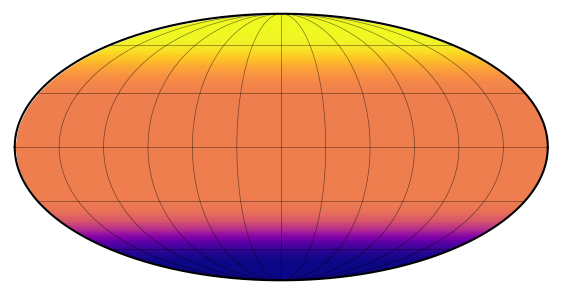

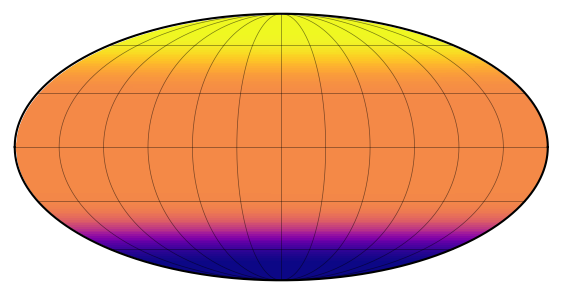

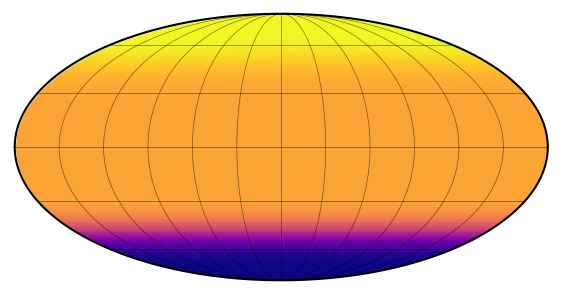

In [125]:
for i in range(4):
    sp.visualize(np.mean(samples_fromfile.posterior[f'max_map_{i}'][0].values, axis=0))

In [126]:
import pandas as pd
data_dict = {var: samples_fromfile.posterior[var].values.flatten() for var in free}
samples_df = pd.DataFrame(data_dict, columns=free)

In [127]:
sample_full_flux = np.hstack((samples_fromfile.posterior['flux_model_0'][0].values, samples_fromfile.posterior['flux_model_1'][0].values, samples_fromfile.posterior['flux_model_2'][0].values, samples_fromfile.posterior['flux_model_3'][0].values))
sample_full_map = np.hstack((samples_fromfile.posterior['max_map_0'][0].values, samples_fromfile.posterior['max_map_1'][0].values, samples_fromfile.posterior['max_map_2'][0].values, samples_fromfile.posterior['max_map_3'][0].values))

In [128]:
np.all(idx) == False

True

Got error No model on context stack. trying to find log_likelihood in translation.
Got error No model on context stack. trying to find log_likelihood in translation.


array([[<Axes: title={'center': 'planet.inc'}>,
        <Axes: title={'center': 'planet.inc'}>],
       [<Axes: title={'center': 'planet.ecc'}>,
        <Axes: title={'center': 'planet.ecc'}>],
       [<Axes: title={'center': 'planet.porb'}>,
        <Axes: title={'center': 'planet.porb'}>],
       [<Axes: title={'center': 'planet.t0'}>,
        <Axes: title={'center': 'planet.t0'}>],
       [<Axes: title={'center': 'planet.r'}>,
        <Axes: title={'center': 'planet.r'}>],
       [<Axes: title={'center': 'planet.w'}>,
        <Axes: title={'center': 'planet.w'}>],
       [<Axes: title={'center': 'star.inc'}>,
        <Axes: title={'center': 'star.inc'}>],
       [<Axes: title={'center': 'star.u1'}>,
        <Axes: title={'center': 'star.u1'}>],
       [<Axes: title={'center': 'star.u2'}>,
        <Axes: title={'center': 'star.u2'}>],
       [<Axes: title={'center': 'star.prot'}>,
        <Axes: title={'center': 'star.prot'}>],
       [<Axes: title={'center': 'star.obl'}>,
        <A

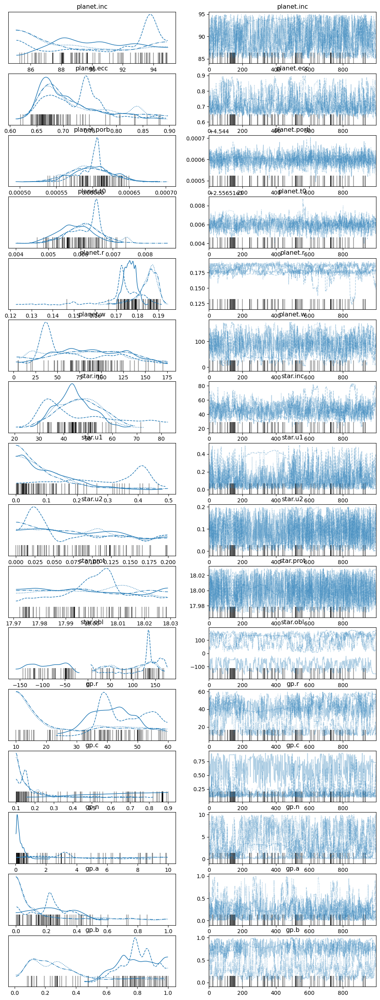

In [138]:
az.plot_trace(trace,var_names=free)

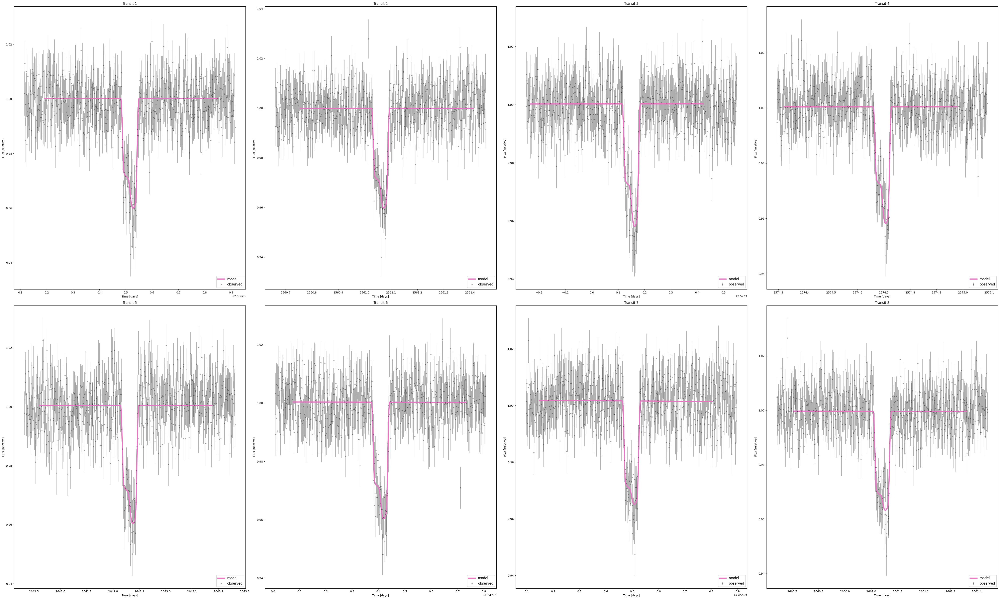

In [129]:
plt.figure(figsize=(50, 30))

transit_count = 0
n = 0

while transit_count < 8:
    i = 0
    idx = (total_t > planet.t0.eval()+(i+n)*planet.porb.eval()-0.4) & (total_t < planet.t0.eval()+(i+n)*planet.porb.eval()+0.4)
    
    # Check if there's data for this transit
    if np.sum(idx) > 0:
        plt.subplot(2, 4, transit_count+1)
        
        plt.errorbar(total_t[idx], total_flux[idx], yerr=total_sigma[idx], alpha=0.3, label="observed", color='k', fmt='.')
        
        model_idx = (t > planet.t0.eval()+(i+n)*planet.porb.eval()-0.4) & (t < planet.t0.eval()+(i+n)*planet.porb.eval()+0.4)
        plt.plot(t[model_idx], np.mean(sample_full_flux, axis=0)[model_idx], "C6", label="model", alpha=1, lw=4)
        
        plt.legend(fontsize=12, loc="lower right")
        plt.xlabel("Time [days]")
        plt.ylabel("Flux [relative]")
        plt.title(f"Transit {transit_count + 1}")
        
        transit_count += 1
    
    n += 1
    
    # Break the loop if we've checked too many transits without finding 8
    if n > 100:  # Increased from 20 to 100 to allow for more sparse data
        print(f"Warning: Only found {transit_count} transits with data after checking 100 periods.")
        break

plt.tight_layout()
plt.show()

In [300]:
samples_fromfile.posterior['planet.porb'].values.shape

(4, 1000)

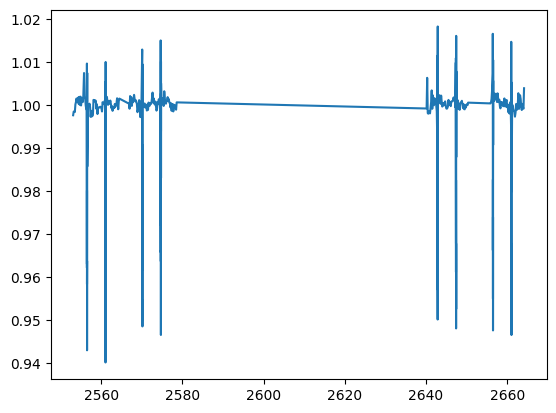

In [311]:
plt.plot(t, flux_obs)

In [132]:
import random

In [133]:
def plot_sample_maps(samples_dict, moll, traj):
    n_samples = 9
    fig, ax = plt.subplots(3, 3, figsize=(20, 8))
    axes = ax.flatten()

    for i in range(n_samples):
        chain = random.randint(0,3)
        random_sample = random.randint(0,999)

        map = starry.Map(15, 2)
        map.inc = samples_dict['star.inc'].values[chain][random_sample]
        map.obl = abs(samples_dict['star.obl'].values[chain][random_sample])
        map[1] = samples_dict['star.u1'].values[chain][random_sample]
        map[2] = samples_dict['star.u2'].values[chain][random_sample]
        star = starry.Primary(map, r=params["star.r"]["truth"], m=params["star.m"]["truth"], prot=samples_dict['star.prot'].values[chain][random_sample]) 
        planet = starry.Secondary(
            starry.Map(0,0),
            inc=samples_dict['planet.inc'].values[chain][random_sample],
            ecc=samples_dict['planet.ecc'].values[chain][random_sample],
            Omega=params["planet.Omega"]["truth"],
            porb=samples_dict['planet.porb'].values[chain][random_sample],
            t0=samples_dict['planet.t0'].values[chain][random_sample],
            r=params["planet.r"]["truth"],
            m=params["planet.m"]["truth"],
            w=samples_dict['planet.w'].values[chain][random_sample],
        )

        sys = starry.System(star, planet)
        xo, yo, zo = sys.position(t)
        xo = xo.eval()[1]
        yo = yo.eval()[1]
        zo = zo.eval()[1]
        theta = (360 * t / params["star.prot"]["truth"]) % 360

        # *** Draw 1 sample from the GP
        sp = StarryProcess(
            a=samples_dict['gp.a'].values[chain][random_sample],
            b=samples_dict['gp.b'].values[chain][random_sample],
            r=samples_dict['gp.r'].values[chain][random_sample],
            c=samples_dict['gp.c'].values[chain][random_sample],
            n=samples_dict['gp.n'].values[chain][random_sample],
        )

        y_sample = sp.sample_ylm().eval().reshape(-1)
        y_sample[0] += 1

        if moll:
            sp.visualize(y_sample, ax=axes[i])

        if traj:
            xo, yo, zo = sys.position(t)
            xo = xo.eval()[1]
            yo = yo.eval()[1]
            zo = zo.eval()[1]
            idx = (zo > 0) | (xo ** 2 + yo ** 2 > 1)
            axes[i].plot(xo[idx], yo[idx], "k.", ms=1);
            axes[i].set_aspect(1)
            axes[i].axis("off")
            map[:, :] = y_sample
            map.show(ax=axes[i])

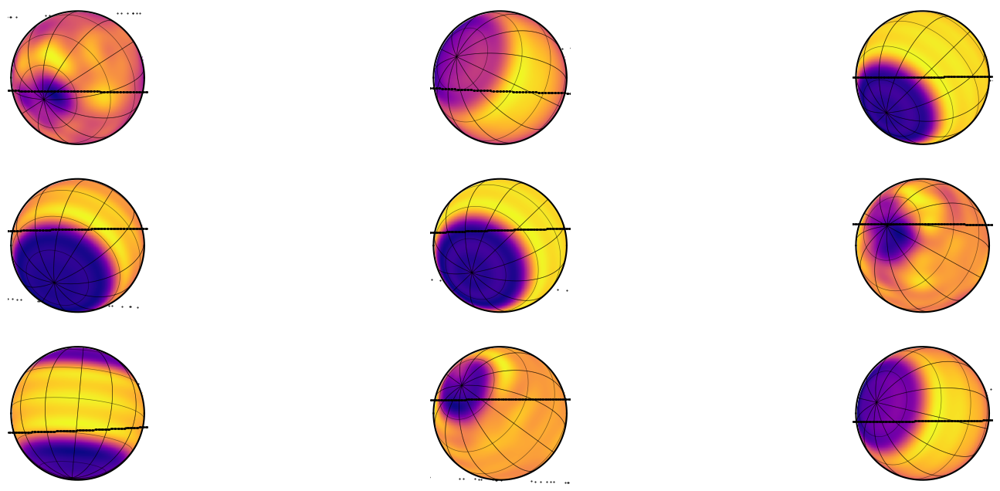

In [134]:
plot_sample_maps(samples_fromfile.posterior, moll=False, traj=True)

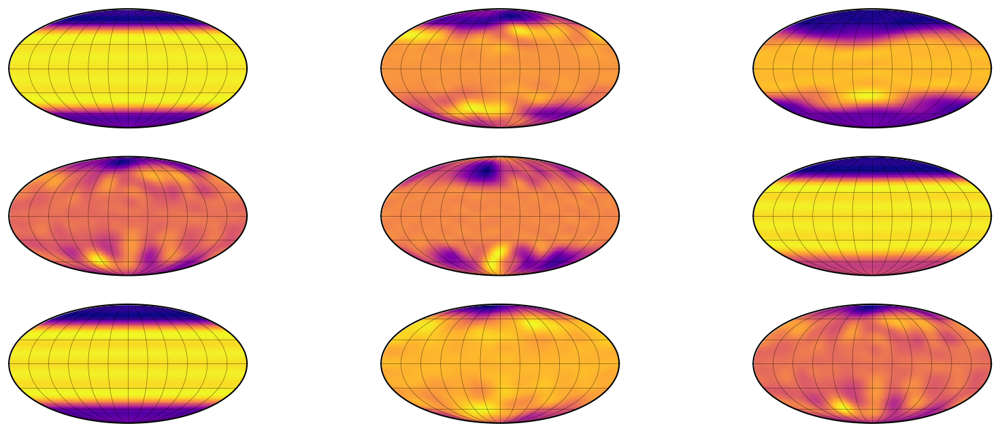

In [135]:
plot_sample_maps(samples_fromfile.posterior, moll=True, traj=False)